## **Model Trainning**

Encoder Model is deveelpoed using pretrained VGG weights

CBAM (Convolution Block Attention Mechanism) is used as Attention Mechanism



```
# Trained on Colab GPU
```



In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
%cd /content/drive/MyDrive/FYP2/Test_Models/VGG2

/content/drive/MyDrive/FYP2/Test_Models/VGG2


In [ ]:
import os
import cv2
import numpy as np
from matplotlib import pyplot as plt

import tensorflow as tf
from tensorflow.keras.layers import Conv2D, BatchNormalization, Activation, MaxPool2D, Conv2DTranspose, Concatenate, Input
from tensorflow.keras.models import Model
from tensorflow.keras.applications.vgg16 import VGG16

from tensorflow.keras.layers import GlobalAveragePooling2D, GlobalMaxPooling2D, Reshape, Dense, Input
from tensorflow.keras.layers import Multiply

In [ ]:
HOME = os. getcwd()
print(HOME)

/content/drive/MyDrive/FYP2/Test_Models/VGG_LowLight_v1


In [ ]:
# Avoid OOM errors by setting GPU Memory Consumption Growth
gpus = tf.config.experimental.list_physical_devices('GPU')
for gpu in gpus: 
    tf.config.experimental.set_memory_growth(gpu, True)

In [ ]:
gpus

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

In [ ]:
SEED = 0
np.random.seed(SEED)
tf.random.set_seed(SEED)

## 1- **Data Processing**

In [ ]:
def load_image(x): 
    print(x)
    byte_img = tf.io.read_file(x)
    img = tf.io.decode_jpeg(byte_img)
    return img

In [ ]:
IMAGE_WIDTH = 512
IMAGE_HEIGHT = 512
BATCH_SIZE = 2

### **Train**

In [ ]:
train_x_images = tf.data.Dataset.list_files('/content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/our485/low/*.png', shuffle=False)
print(train_x_images)
#train_x_images = train_x_images.take(100)
train_x_images = train_x_images.map(load_image)  # map -- > do same for every image
print(train_x_images)
train_x_images = train_x_images.map(lambda x: tf.image.resize(x, (IMAGE_WIDTH,IMAGE_HEIGHT)))
print(train_x_images)
train_x_images = train_x_images.map(lambda x: x/255)

<_TensorSliceDataset element_spec=TensorSpec(shape=(), dtype=tf.string, name=None)>
Tensor("args_0:0", shape=(), dtype=string)
<_MapDataset element_spec=TensorSpec(shape=(None, None, None), dtype=tf.uint8, name=None)>
<_MapDataset element_spec=TensorSpec(shape=(512, 512, None), dtype=tf.float32, name=None)>


In [ ]:
train_y_images = tf.data.Dataset.list_files('/content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/our485/high/*.png', shuffle=False)
#train_y_images = train_y_images.take(100)
train_y_images = train_y_images.map(load_image)  
train_y_images = train_y_images.map(lambda x: tf.image.resize(x, (IMAGE_WIDTH,IMAGE_HEIGHT)))
train_y_images = train_y_images.map(lambda x: x/255)

Tensor("args_0:0", shape=(), dtype=string)


In [ ]:
# combine input and output
train = tf.data.Dataset.zip((train_x_images, train_y_images))
train = train.shuffle(100)
train = train.batch(BATCH_SIZE)

## **Val**

In [ ]:
val_x_images = tf.data.Dataset.list_files('/content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low/*.png', shuffle=False)
val_x_images = val_x_images.map(load_image)  # map -- > do same for every image
val_x_images = val_x_images.map(lambda x: tf.image.resize(x, (IMAGE_WIDTH,IMAGE_HEIGHT)))
val_x_images = val_x_images.map(lambda x: x/255)

Tensor("args_0:0", shape=(), dtype=string)


In [ ]:
val_y_images = tf.data.Dataset.list_files('/content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/high/*.png', shuffle=False)
val_y_images = val_y_images.map(load_image)
val_y_images = val_y_images.map(lambda x: tf.image.resize(x, (IMAGE_WIDTH,IMAGE_HEIGHT)))
val_y_images = val_y_images.map(lambda x: x/255)

Tensor("args_0:0", shape=(), dtype=string)


In [ ]:
# combine input and output
val = tf.data.Dataset.zip((val_x_images, val_y_images))
val = val.shuffle(100)
val = val.batch(BATCH_SIZE)

## **Test**

In [ ]:
test_x_images = tf.data.Dataset.list_files('/content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low/*.png', shuffle=False)
test_x_images = test_x_images.map(load_image)  
test_x_images = test_x_images.map(lambda x: tf.image.resize(x, (IMAGE_WIDTH,IMAGE_HEIGHT)))
test_x_images = test_x_images.map(lambda x: x/255)

Tensor("args_0:0", shape=(), dtype=string)


In [ ]:
test_y_images = tf.data.Dataset.list_files('/content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/high/*.png', shuffle=False)
test_y_images = test_y_images.map(load_image)
test_y_images = test_y_images.map(lambda x: tf.image.resize(x, (IMAGE_WIDTH,IMAGE_HEIGHT)))
test_y_images = test_y_images.map(lambda x: x/255)

Tensor("args_0:0", shape=(), dtype=string)


In [ ]:
# combine input and output
test = tf.data.Dataset.zip((test_x_images, test_y_images))
test = test.shuffle(100)
test = test.batch(BATCH_SIZE)

## **View Samples**

In [ ]:
# data iterator
data_samples = train.as_numpy_iterator()

In [ ]:
res = data_samples.next()
print(len(res))
res[0].shape

2


(2, 512, 512, 3)

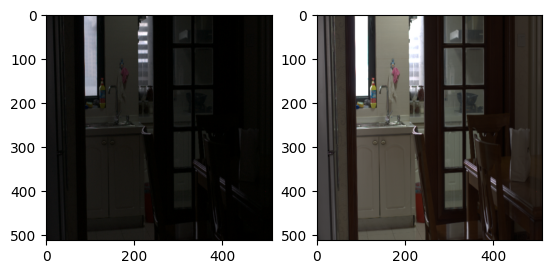

In [ ]:
res_low_1 = res[0][0]
res_high_1 = res[1][0]

fig, axs = plt.subplots(ncols=2);
axs[0].imshow(res_low_1)
axs[1].imshow(res_high_1)

#2- **Model Building**

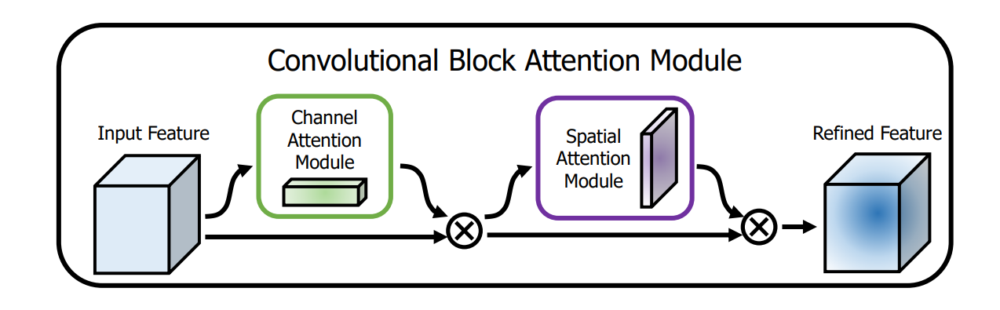

In [ ]:
def channel_attention_module(x, ratio=8):
    batch, _, _, channel = x.shape

    ## Shared layers
    l1 = Dense(channel//ratio, activation="relu", use_bias=False)
    l2 = Dense(channel, use_bias=False)

    ## Global Average Pooling
    x1 = GlobalAveragePooling2D()(x)
    x1 = l1(x1)
    x1 = l2(x1)

    ## Global Max Pooling
    x2 = GlobalMaxPooling2D()(x)
    x2 = l1(x2)
    x2 = l2(x2)

    ## Add both the features and pass through sigmoid
    feats = x1 + x2
    feats = Activation("sigmoid")(feats)
    feats = Multiply()([x, feats])

    return feats

def spatial_attention_module(x):
    ## Average Pooling
    x1 = tf.reduce_mean(x, axis=-1)
    x1 = tf.expand_dims(x1, axis=-1)

    ## Max Pooling
    x2 = tf.reduce_max(x, axis=-1)
    x2 = tf.expand_dims(x2, axis=-1)

    ## Concatenat both the features
    feats = Concatenate()([x1, x2])
    ## Conv layer
    feats = Conv2D(1, kernel_size=7, padding="same", activation="sigmoid")(feats)
    feats = Multiply()([x, feats])

    return feats

def CBAM(x):
    x = channel_attention_module(x)
    x = spatial_attention_module(x)
    return x


# inputs = Input(shape=(128, 128, 32))
# y = cbam(inputs)
# print(y.shape)

In [ ]:
def conv_block(input, num_filters):
    x = Conv2D(num_filters, 3, padding="same")(input)
    x = BatchNormalization()(x)
    x = Activation("relu")(x)

    x = Conv2D(num_filters, 3, padding="same")(x)
    x = BatchNormalization()(x)
    x = Activation("relu")(x)

    return x

In [ ]:
def encoder_block(input, num_filters):
    x = conv_block(input, num_filters)
    p = MaxPool2D((2, 2))(x)
    return x, p

In [ ]:
def decoder_block(input, skip_features, num_filters):
    x = Conv2DTranspose(num_filters, (2, 2), strides=2, padding="same")(input)
    x = Concatenate()([x, skip_features])
    x = conv_block(x, num_filters)
    return x

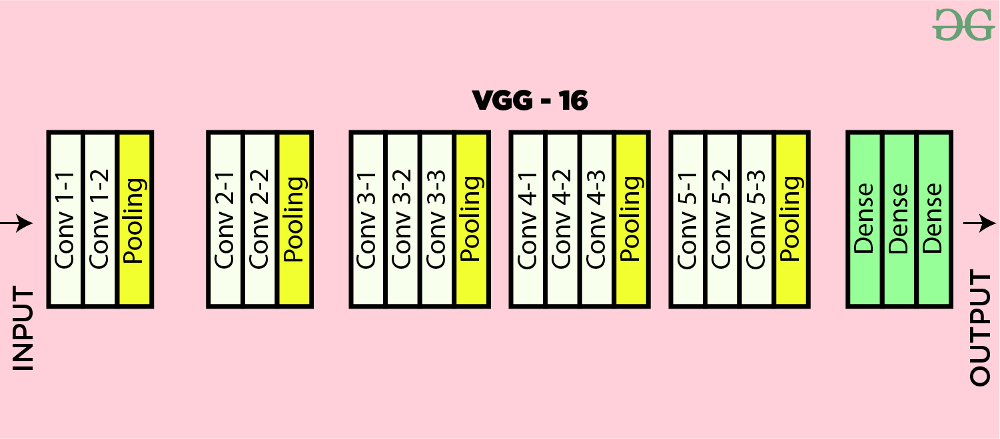

In [ ]:
# input_shape = (512,512,3)
# inputs = Input(input_shape)

# vgg_model = VGG16(include_top=False, weights="imagenet",input_tensor=inputs)
# vgg_model.summary()

# # Encoder
# s1 = vgg_model.layers[0].output                  ## (512 x 512)
# #s1 = vgg_model.get_layer("block2_conv2").output    ## (512 x 512)
# s2 = vgg_model.get_layer("block2_conv2").output    ## (256 x 256)
# s3 = vgg_model.get_layer("block3_conv3").output    ## (128 x 128)
# s4 = vgg_model.get_layer("block4_conv3").output    ## (64 x 64)

# b1 = vgg_model.get_layer("block5_conv3").output    ## (32 x 32)

# # Decoder
# d1 = decoder_block(b1, s4, 512)                    ## (64 x 64)
# d2 = decoder_block(d1, s3, 256)                    ## (128 x 128)
# d3 = decoder_block(d2, s2, 128)                    ## (256 x 256)
# d4 = decoder_block(d3, s1, 64)                     ## (512 x 512)

# # Output
# outputs = Conv2D(3, 1, padding="same", activation="sigmoid")(d4)

# model = Model(inputs, outputs, name="VGG_Model_LowLight_Enhancement")
# model.summary()

In [ ]:
# layer = keras.layers.Dense(3)
# layer.build((None, 4))  # Create the weights
# layer.trainable = False  # Freeze the layer

# print("weights:", len(layer.weights))
# print("trainable_weights:", len(layer.trainable_weights))
# print("non_trainable_weights:", len(layer.non_trainable_weights))

In [ ]:
def build_model(input_shape):
    input_shape = (512,512,3)
    inputs = Input(input_shape)

    vgg_model = VGG16(include_top=False, weights="imagenet",input_tensor=inputs)
    vgg_model.trainable = False
    # vgg_model.summary()

    # Encoder
    s1 = vgg_model.layers[0].output                                             ## (512 x 512)
    s2 = vgg_model.get_layer("block2_conv2").output                             ## (256 x 256)
    s3 = vgg_model.get_layer("block3_conv3").output                             ## (128 x 128)
    s4 = vgg_model.get_layer("block4_conv3").output                             ## (64 x 64)

    b1 = vgg_model.get_layer("block5_conv3").output                             ## (32 x 32)

    # Attention 
    s1 = CBAM(s1)
    s2 = CBAM(s2)
    s3 = CBAM(s3)
    s4 = CBAM(s4)

    # Decoder
    d1 = decoder_block(b1, s4, 512)                                             ## (64 x 64)
    d2 = decoder_block(d1, s3, 256)                                             ## (128 x 128)
    d3 = decoder_block(d2, s2, 128)                                             ## (256 x 256)
    d4 = decoder_block(d3, s1, 64)                                              ## (512 x 512)

    # Output
    outputs = Conv2D(3, 1, padding="same", activation="sigmoid")(d4)

    model = Model(inputs, outputs, name="VGG_Model_LowLight_Enhancement")
    return model

In [ ]:
input_shape = (512, 512, 3)
model = build_model(input_shape)
model.summary()

In [ ]:
tf.keras.utils.plot_model(
    model,
    to_file="model_v2.png",
    show_shapes=True,
    show_layer_activations=True,
)

In [ ]:
print("trainable_weights:", len(model.trainable_weights))
print("non_trainable_weights:", len(model.non_trainable_weights))

trainable_weights: 58
non_trainable_weights: 42


## **Setup Losses and Optimizer**

In [ ]:
#optimizer = tf.keras.optimizers.experimental.AdamW(learning_rate=0.0001,weight_decay=0.004)
optimizer = tf.keras.optimizers.Adam(learning_rate=3e-4)
MSEloss = tf.keras.losses.MeanSquaredError()

In [ ]:
def charbonnier_loss(y_true, y_pred):
    return tf.reduce_mean(tf.sqrt(tf.square(y_true - y_pred) + tf.square(1e-3)))

def psnr_loss_fn(y_true, y_pred):
    return tf.image.psnr(y_pred, y_true, max_val=255.0)

def ssim_loss_fn(y_true,y_pred):
    return tf.image.ssim(y_true,y_pred,1.0)


def compute_total_loss(y_true, y_pred):
  ssim =  ssim_loss_fn(y_true,y_pred)
  psnr = psnr_loss_fn(y_true, y_pred)

  #total_loss = 10*ssim + psnr
  total_loss = psnr
  return total_loss


*   callbacks to save best model

*   And Infer the Model while trainning

*   Tensorboard Callback

In [ ]:
from keras.callbacks import ModelCheckpoint

# tensorboard callback
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir="./logs")

# save_best_model_callback
from datetime import datetime
model_save_folder = datetime.now().strftime("%Y%m%d_%H%M%S")
model_save_dir = f'models/{model_save_folder}'
#model_save_dir = f'models'

if not os.path.exists(model_save_dir):
  print("FOLDER CREATED")
  os.makedirs(model_save_dir)

save_best_model_checkpoint = ModelCheckpoint(model_save_dir+'/model-{epoch:03d}.hdf5',monitor='val_loss',save_best_only=True,mode='auto')

FOLDER CREATED


In [ ]:
def load_image(x): 
    byte_img = tf.io.read_file(x)
    img = tf.io.decode_jpeg(byte_img)
    return img

In [ ]:
def preprocess_image(img_path):
  img = load_image(img_path)
  img = tf.image.resize(img, (IMAGE_WIDTH,IMAGE_HEIGHT))
  img = img/255;
  return img

In [ ]:
test_low_path = r'/content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low'
test_high_path = r'/content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/high'

In [ ]:
def find_target_img_path(test_img_file):
  test_img_filename = os.path.basename(test_img_file)
  high_img_path = os.path.join(test_high_path,test_img_filename)
  return high_img_path

In [ ]:
def infer(n_images=2):
  test_low_images = os.listdir(test_low_path)

  for i,image_name in enumerate(test_low_images):
    if i == n_images:
      break
    image_path = os.path.join(test_low_path,image_name)
    print(f'{i+1}/{n_images} : {image_path}')
    low_img = preprocess_image(image_path)
    prediction = model.predict(np.expand_dims(low_img,axis=0),verbose=0)

    high_img_path = find_target_img_path(image_path)
    high_img = preprocess_image(high_img_path)

    fig, ax = plt.subplots(ncols=3, figsize=(15,10));
    ax[0].imshow(low_img);
    ax[1].imshow(prediction[0]);
    ax[2].imshow(high_img);
    ax[0].axis('off');
    ax[1].axis('off');
    ax[2].axis('off');
    ax[0].set_title("Low Image")
    ax[1].set_title("Predicted Image")
    ax[2].set_title("High Image")
    plt.show()

In [ ]:
from tensorflow.keras import callbacks
class PredictionCallback(callbacks.Callback):
    def __init__(self, log_interval, *args, **kwargs):
        super().__init__(*args, **kwargs)
        #self.image_files = image_files
        self.log_interval = log_interval
    
    def on_epoch_end(self, epoch, logs=None):
        if epoch % self.log_interval == 0: 
          infer(n_images=2)
          

In [ ]:
#model.compile(optimizer,loss, metrics = [charbonnier_loss,psnr_loss_fn,ssim_loss_fn])
model.compile(optimizer,charbonnier_loss, metrics = [MSEloss,psnr_loss_fn,ssim_loss_fn])

## **Sense the predictions**

In [ ]:
X, y = train.as_numpy_iterator().next()
X.shape

(2, 512, 512, 3)

1/1 [==============================] - 15s 15s/step


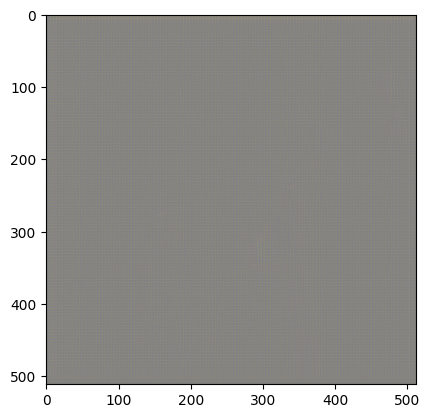

In [ ]:
pred = model.predict(X)
plt.imshow(pred[0]);

In [ ]:
print(pred.shape)

(2, 512, 512, 3)


## **Load Model**

In [ ]:
# from keras.models import load_model
# model_path = r'/content/drive/MyDrive/FYP2/Test_Models/VGG_LowLight_v1/Test_VGG_LowLight_charbonnier_loss.h5'
# model = load_model(model_path,custom_objects={'charbonnier_loss': charbonnier_loss,
#                                               'psnr_loss_fn':psnr_loss_fn,
#                                               'ssim_loss_fn':ssim_loss_fn})

# compile = False

##3- **Train the Model**

In [ ]:
LOG_INTERVALS = 4
EPOCHS = 100

Epoch 1/100
243/243 [==============================] - ETA: 0s - loss: 0.1396 - mean_squared_error: 0.0311 - psnr_loss_fn: 64.0143 - ssim_loss_fn: 0.58451/2 : /content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low/748.png


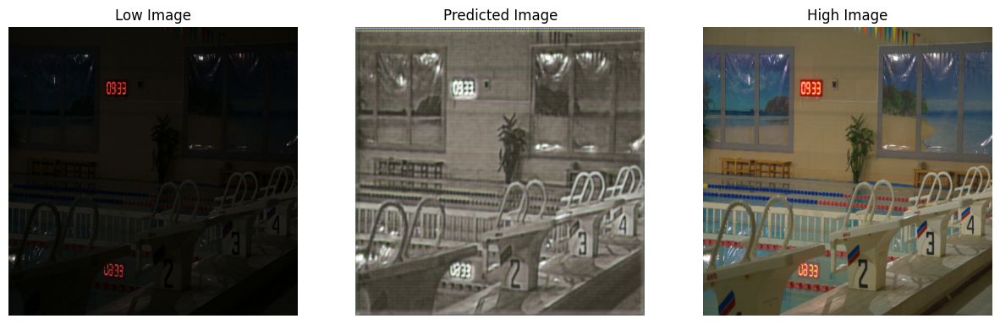

2/2 : /content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low/665.png


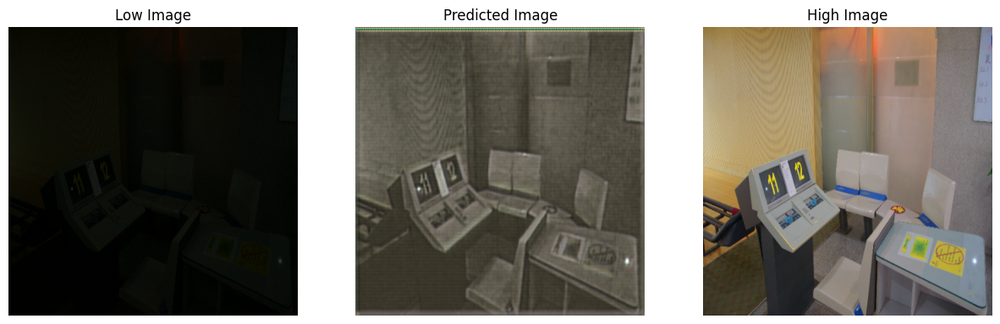

243/243 [==============================] - 161s 530ms/step - loss: 0.1396 - mean_squared_error: 0.0311 - psnr_loss_fn: 64.0143 - ssim_loss_fn: 0.5845 - val_loss: 0.1427 - val_mean_squared_error: 0.0338 - val_psnr_loss_fn: 64.0871 - val_ssim_loss_fn: 0.5196
Epoch 2/100
243/243 [==============================] - 95s 384ms/step - loss: 0.1196 - mean_squared_error: 0.0228 - psnr_loss_fn: 65.5312 - ssim_loss_fn: 0.7277 - val_loss: 0.1794 - val_mean_squared_error: 0.0505 - val_psnr_loss_fn: 62.7889 - val_ssim_loss_fn: 0.6759
Epoch 3/100
243/243 [==============================] - 96s 386ms/step - loss: 0.1124 - mean_squared_error: 0.0202 - psnr_loss_fn: 66.1823 - ssim_loss_fn: 0.7408 - val_loss: 0.1058 - val_mean_squared_error: 0.0185 - val_psnr_loss_fn: 66.6272 - val_ssim_loss_fn: 0.6931
Epoch 4/100
243/243 [==============================] - 95s 384ms/step - loss: 0.1093 - mean_squared_error: 0.0194 - psnr_loss_fn: 66.5216 - ssim_loss_fn: 0.7544 - val_loss: 0.1116 - val_mean_squared_error: 0

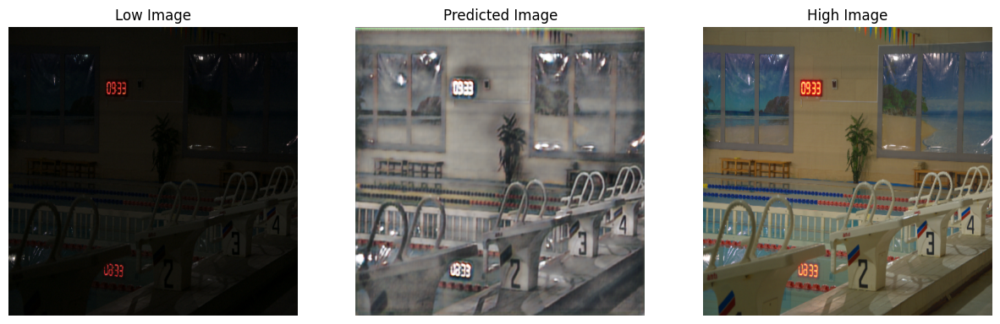

2/2 : /content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low/665.png


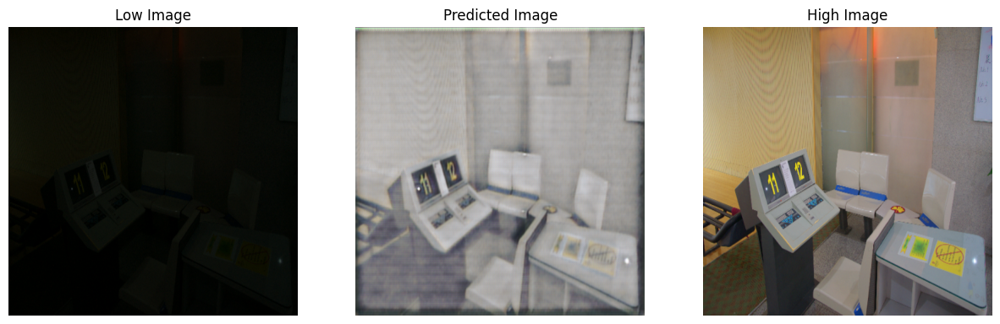

243/243 [==============================] - 97s 389ms/step - loss: 0.1113 - mean_squared_error: 0.0200 - psnr_loss_fn: 66.3742 - ssim_loss_fn: 0.7565 - val_loss: 0.1346 - val_mean_squared_error: 0.0283 - val_psnr_loss_fn: 64.0630 - val_ssim_loss_fn: 0.6966
Epoch 6/100
243/243 [==============================] - 95s 383ms/step - loss: 0.1075 - mean_squared_error: 0.0187 - psnr_loss_fn: 66.6266 - ssim_loss_fn: 0.7550 - val_loss: 0.1318 - val_mean_squared_error: 0.0273 - val_psnr_loss_fn: 64.8170 - val_ssim_loss_fn: 0.7083
Epoch 7/100
243/243 [==============================] - 96s 387ms/step - loss: 0.1064 - mean_squared_error: 0.0183 - psnr_loss_fn: 66.8181 - ssim_loss_fn: 0.7639 - val_loss: 0.1081 - val_mean_squared_error: 0.0200 - val_psnr_loss_fn: 66.7512 - val_ssim_loss_fn: 0.7421
Epoch 8/100
243/243 [==============================] - 95s 382ms/step - loss: 0.1030 - mean_squared_error: 0.0171 - psnr_loss_fn: 67.0840 - ssim_loss_fn: 0.7711 - val_loss: 0.1224 - val_mean_squared_error: 0.

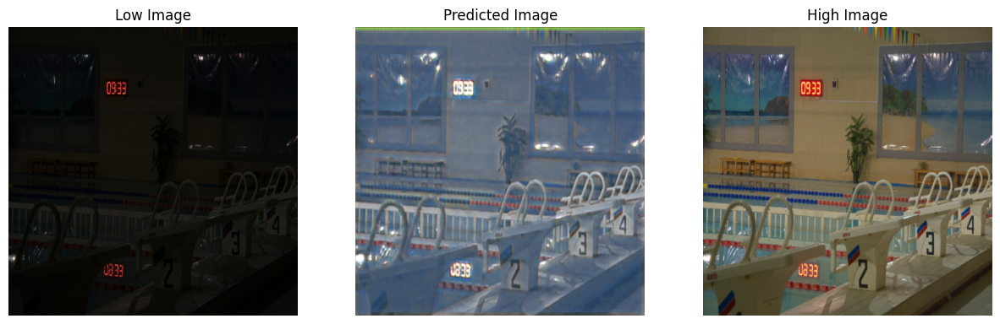

2/2 : /content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low/665.png


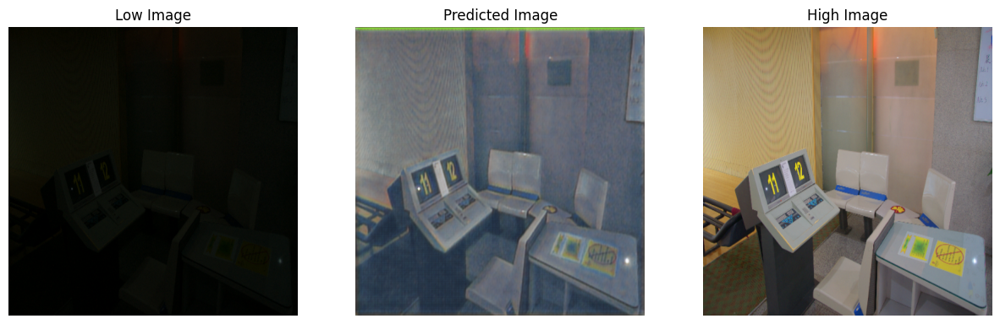

243/243 [==============================] - 98s 390ms/step - loss: 0.1013 - mean_squared_error: 0.0166 - psnr_loss_fn: 67.1943 - ssim_loss_fn: 0.7721 - val_loss: 0.1176 - val_mean_squared_error: 0.0232 - val_psnr_loss_fn: 65.9252 - val_ssim_loss_fn: 0.7173
Epoch 10/100
243/243 [==============================] - 97s 394ms/step - loss: 0.1005 - mean_squared_error: 0.0162 - psnr_loss_fn: 67.3346 - ssim_loss_fn: 0.7757 - val_loss: 0.0969 - val_mean_squared_error: 0.0189 - val_psnr_loss_fn: 67.5866 - val_ssim_loss_fn: 0.7438
Epoch 11/100
243/243 [==============================] - 93s 376ms/step - loss: 0.1017 - mean_squared_error: 0.0167 - psnr_loss_fn: 67.2713 - ssim_loss_fn: 0.7747 - val_loss: 0.1041 - val_mean_squared_error: 0.0182 - val_psnr_loss_fn: 67.2034 - val_ssim_loss_fn: 0.7569
Epoch 12/100
243/243 [==============================] - 94s 382ms/step - loss: 0.0985 - mean_squared_error: 0.0156 - psnr_loss_fn: 67.4376 - ssim_loss_fn: 0.7775 - val_loss: 0.1141 - val_mean_squared_error:

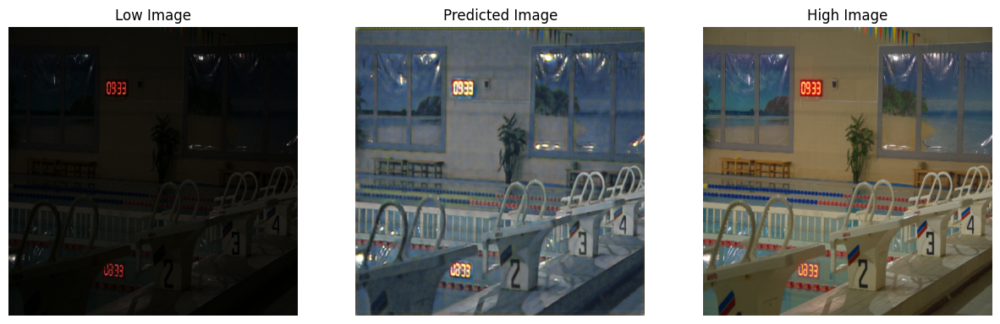

2/2 : /content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low/665.png


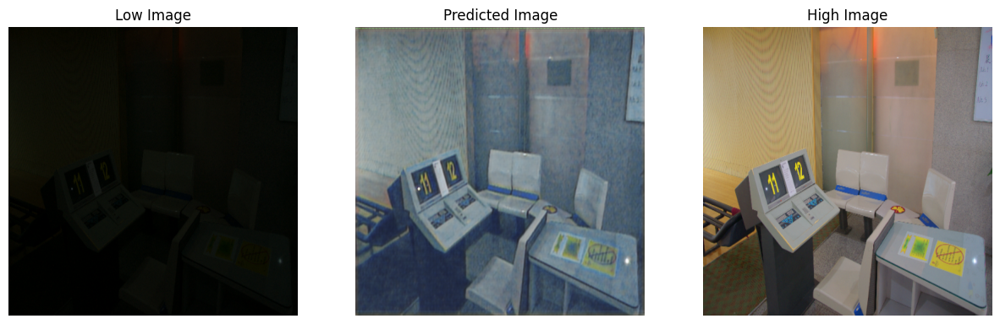

243/243 [==============================] - 97s 389ms/step - loss: 0.0979 - mean_squared_error: 0.0156 - psnr_loss_fn: 67.5658 - ssim_loss_fn: 0.7823 - val_loss: 0.1008 - val_mean_squared_error: 0.0170 - val_psnr_loss_fn: 67.1773 - val_ssim_loss_fn: 0.7548
Epoch 14/100
243/243 [==============================] - 93s 373ms/step - loss: 0.0958 - mean_squared_error: 0.0149 - psnr_loss_fn: 67.7902 - ssim_loss_fn: 0.7841 - val_loss: 0.1019 - val_mean_squared_error: 0.0169 - val_psnr_loss_fn: 67.0210 - val_ssim_loss_fn: 0.7588
Epoch 15/100
243/243 [==============================] - 94s 376ms/step - loss: 0.0956 - mean_squared_error: 0.0145 - psnr_loss_fn: 67.7562 - ssim_loss_fn: 0.7881 - val_loss: 0.0826 - val_mean_squared_error: 0.0121 - val_psnr_loss_fn: 68.8355 - val_ssim_loss_fn: 0.7762
Epoch 16/100
243/243 [==============================] - 92s 372ms/step - loss: 0.0923 - mean_squared_error: 0.0140 - psnr_loss_fn: 68.0493 - ssim_loss_fn: 0.7912 - val_loss: 0.0922 - val_mean_squared_error:

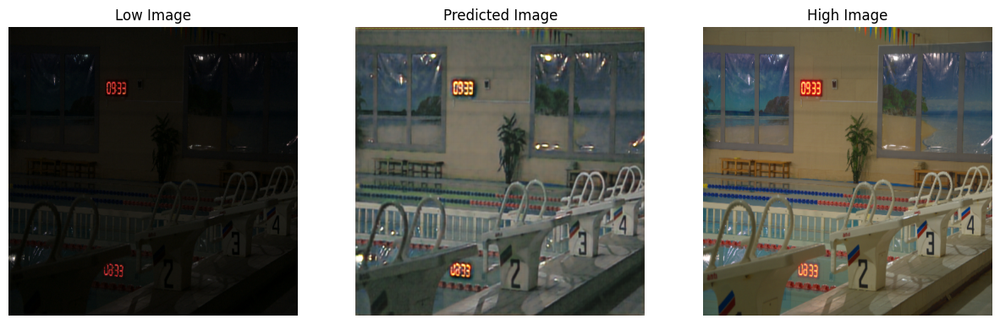

2/2 : /content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low/665.png


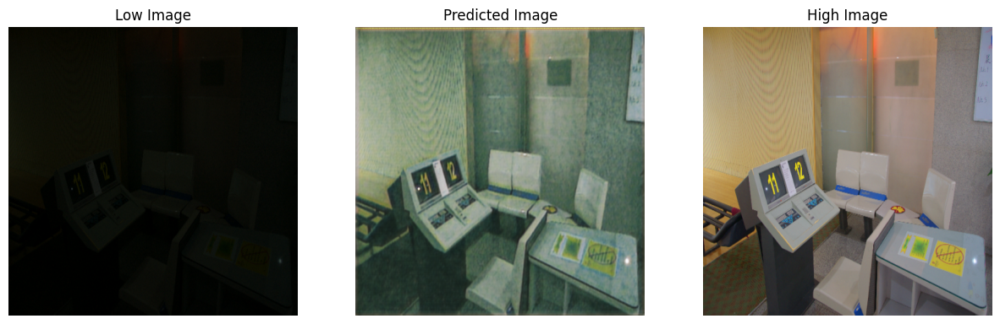

243/243 [==============================] - 95s 385ms/step - loss: 0.0892 - mean_squared_error: 0.0131 - psnr_loss_fn: 68.4059 - ssim_loss_fn: 0.7954 - val_loss: 0.0886 - val_mean_squared_error: 0.0131 - val_psnr_loss_fn: 68.1167 - val_ssim_loss_fn: 0.7721
Epoch 18/100
243/243 [==============================] - 95s 382ms/step - loss: 0.0909 - mean_squared_error: 0.0137 - psnr_loss_fn: 68.3348 - ssim_loss_fn: 0.7912 - val_loss: 0.1005 - val_mean_squared_error: 0.0164 - val_psnr_loss_fn: 66.8454 - val_ssim_loss_fn: 0.7609
Epoch 19/100
243/243 [==============================] - 95s 382ms/step - loss: 0.0891 - mean_squared_error: 0.0131 - psnr_loss_fn: 68.4275 - ssim_loss_fn: 0.7962 - val_loss: 0.1007 - val_mean_squared_error: 0.0154 - val_psnr_loss_fn: 67.2064 - val_ssim_loss_fn: 0.7717
Epoch 20/100
243/243 [==============================] - 95s 382ms/step - loss: 0.0888 - mean_squared_error: 0.0129 - psnr_loss_fn: 68.4853 - ssim_loss_fn: 0.7966 - val_loss: 0.1064 - val_mean_squared_error:

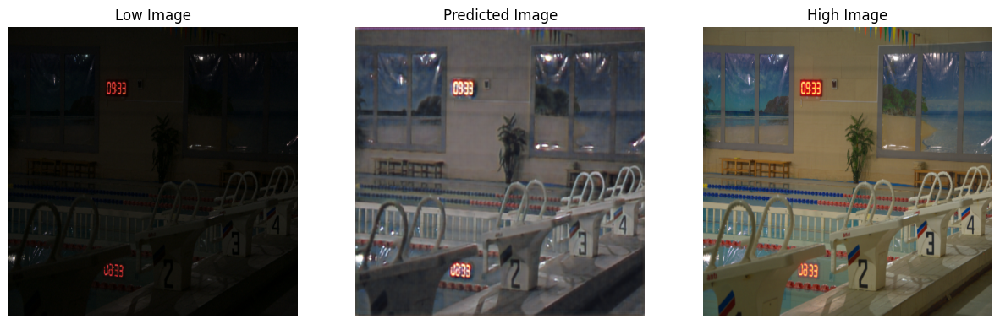

2/2 : /content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low/665.png


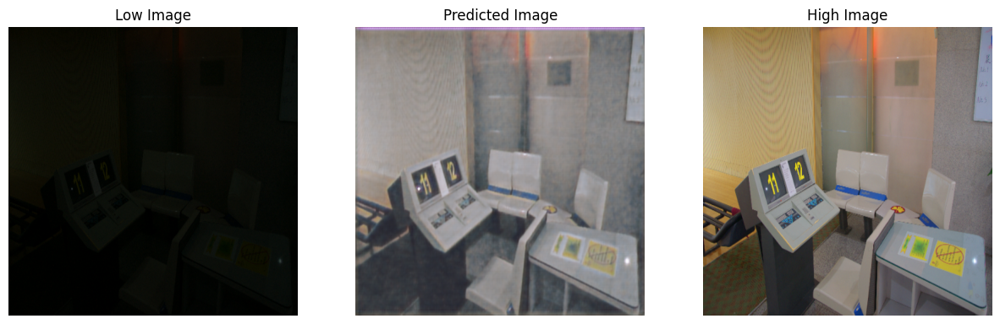

243/243 [==============================] - 96s 389ms/step - loss: 0.0880 - mean_squared_error: 0.0128 - psnr_loss_fn: 68.5638 - ssim_loss_fn: 0.7986 - val_loss: 0.0837 - val_mean_squared_error: 0.0113 - val_psnr_loss_fn: 68.4679 - val_ssim_loss_fn: 0.7755
Epoch 22/100
243/243 [==============================] - 96s 386ms/step - loss: 0.0894 - mean_squared_error: 0.0131 - psnr_loss_fn: 68.3899 - ssim_loss_fn: 0.7951 - val_loss: 0.0911 - val_mean_squared_error: 0.0145 - val_psnr_loss_fn: 68.0905 - val_ssim_loss_fn: 0.7794
Epoch 23/100
243/243 [==============================] - 94s 379ms/step - loss: 0.0883 - mean_squared_error: 0.0125 - psnr_loss_fn: 68.5055 - ssim_loss_fn: 0.7978 - val_loss: 0.0809 - val_mean_squared_error: 0.0127 - val_psnr_loss_fn: 68.9891 - val_ssim_loss_fn: 0.7933
Epoch 24/100
243/243 [==============================] - 94s 380ms/step - loss: 0.0889 - mean_squared_error: 0.0129 - psnr_loss_fn: 68.4202 - ssim_loss_fn: 0.7979 - val_loss: 0.1067 - val_mean_squared_error:

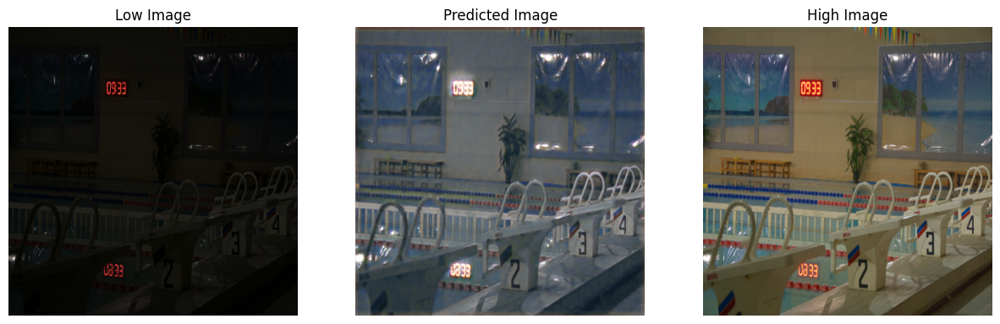

2/2 : /content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low/665.png


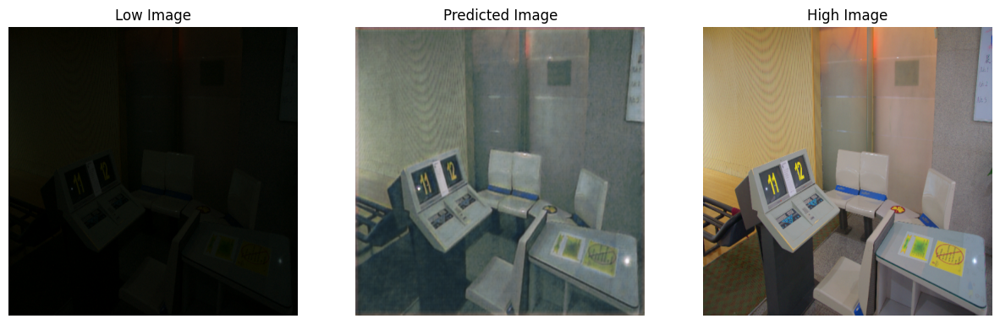

243/243 [==============================] - 97s 389ms/step - loss: 0.0863 - mean_squared_error: 0.0121 - psnr_loss_fn: 68.6026 - ssim_loss_fn: 0.8005 - val_loss: 0.0958 - val_mean_squared_error: 0.0145 - val_psnr_loss_fn: 67.3765 - val_ssim_loss_fn: 0.7748
Epoch 26/100
243/243 [==============================] - 95s 383ms/step - loss: 0.0864 - mean_squared_error: 0.0121 - psnr_loss_fn: 68.7155 - ssim_loss_fn: 0.8048 - val_loss: 0.1020 - val_mean_squared_error: 0.0169 - val_psnr_loss_fn: 66.8296 - val_ssim_loss_fn: 0.7597
Epoch 27/100
243/243 [==============================] - 95s 382ms/step - loss: 0.0855 - mean_squared_error: 0.0120 - psnr_loss_fn: 68.7793 - ssim_loss_fn: 0.8058 - val_loss: 0.0889 - val_mean_squared_error: 0.0130 - val_psnr_loss_fn: 68.3820 - val_ssim_loss_fn: 0.7842
Epoch 28/100
243/243 [==============================] - 96s 381ms/step - loss: 0.0862 - mean_squared_error: 0.0120 - psnr_loss_fn: 68.7823 - ssim_loss_fn: 0.8067 - val_loss: 0.0922 - val_mean_squared_error:

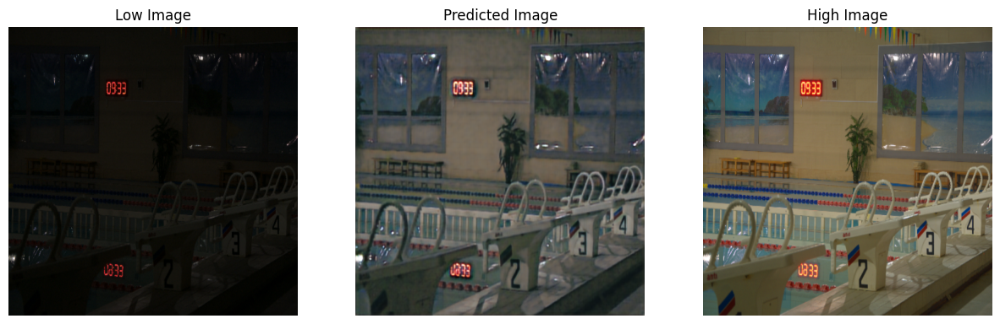

2/2 : /content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low/665.png


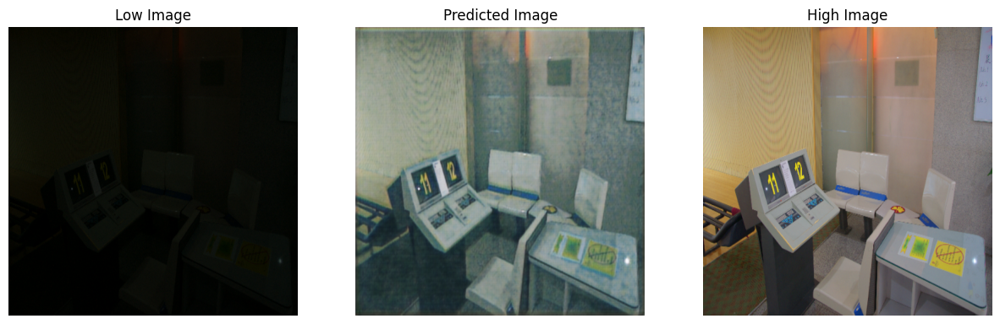

243/243 [==============================] - 97s 393ms/step - loss: 0.0825 - mean_squared_error: 0.0112 - psnr_loss_fn: 69.0873 - ssim_loss_fn: 0.8090 - val_loss: 0.0886 - val_mean_squared_error: 0.0121 - val_psnr_loss_fn: 68.0841 - val_ssim_loss_fn: 0.7737
Epoch 30/100
243/243 [==============================] - 95s 381ms/step - loss: 0.0844 - mean_squared_error: 0.0115 - psnr_loss_fn: 68.8592 - ssim_loss_fn: 0.8078 - val_loss: 0.0881 - val_mean_squared_error: 0.0127 - val_psnr_loss_fn: 68.3274 - val_ssim_loss_fn: 0.7692
Epoch 31/100
243/243 [==============================] - 95s 382ms/step - loss: 0.0822 - mean_squared_error: 0.0113 - psnr_loss_fn: 69.2120 - ssim_loss_fn: 0.8091 - val_loss: 0.0910 - val_mean_squared_error: 0.0129 - val_psnr_loss_fn: 68.0557 - val_ssim_loss_fn: 0.7922
Epoch 32/100
243/243 [==============================] - 96s 382ms/step - loss: 0.0809 - mean_squared_error: 0.0109 - psnr_loss_fn: 69.2884 - ssim_loss_fn: 0.8120 - val_loss: 0.1624 - val_mean_squared_error:

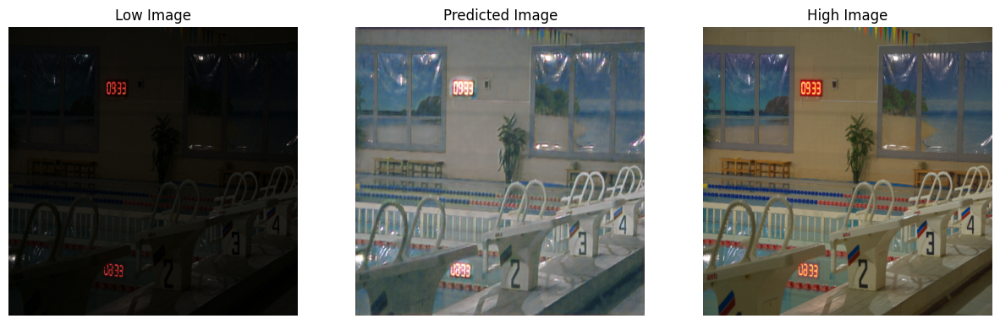

2/2 : /content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low/665.png


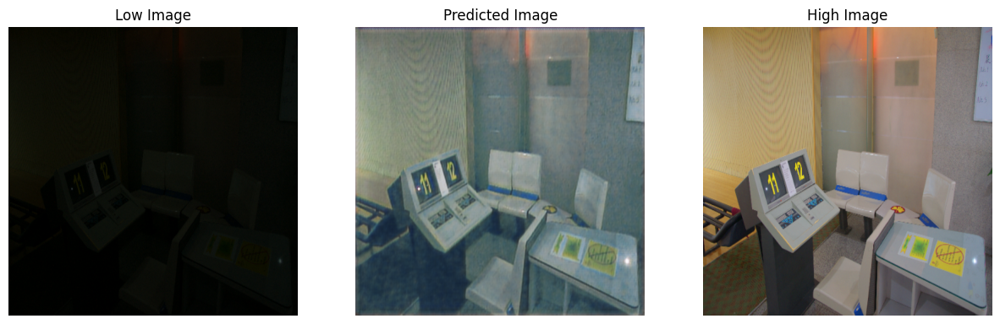

243/243 [==============================] - 97s 391ms/step - loss: 0.0822 - mean_squared_error: 0.0111 - psnr_loss_fn: 69.2096 - ssim_loss_fn: 0.8112 - val_loss: 0.1015 - val_mean_squared_error: 0.0172 - val_psnr_loss_fn: 67.1814 - val_ssim_loss_fn: 0.7782
Epoch 34/100
243/243 [==============================] - 93s 376ms/step - loss: 0.0811 - mean_squared_error: 0.0109 - psnr_loss_fn: 69.3057 - ssim_loss_fn: 0.8139 - val_loss: 0.0904 - val_mean_squared_error: 0.0154 - val_psnr_loss_fn: 68.2151 - val_ssim_loss_fn: 0.7938
Epoch 35/100
243/243 [==============================] - 95s 380ms/step - loss: 0.0803 - mean_squared_error: 0.0106 - psnr_loss_fn: 69.3604 - ssim_loss_fn: 0.8151 - val_loss: 0.0860 - val_mean_squared_error: 0.0115 - val_psnr_loss_fn: 68.4268 - val_ssim_loss_fn: 0.7877
Epoch 36/100
243/243 [==============================] - 95s 382ms/step - loss: 0.0822 - mean_squared_error: 0.0112 - psnr_loss_fn: 69.2518 - ssim_loss_fn: 0.8160 - val_loss: 0.1057 - val_mean_squared_error:

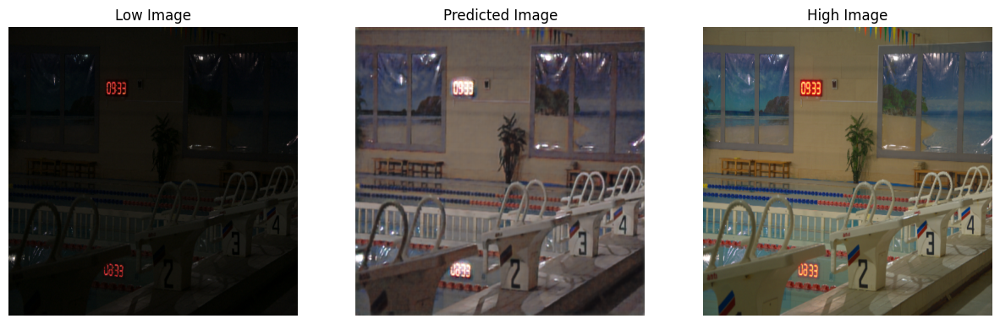

2/2 : /content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low/665.png


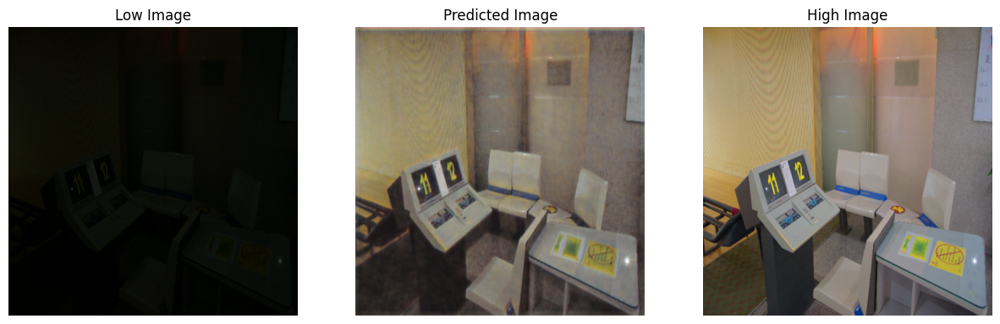

243/243 [==============================] - 98s 389ms/step - loss: 0.0823 - mean_squared_error: 0.0111 - psnr_loss_fn: 69.1813 - ssim_loss_fn: 0.8158 - val_loss: 0.0881 - val_mean_squared_error: 0.0117 - val_psnr_loss_fn: 68.5670 - val_ssim_loss_fn: 0.7873
Epoch 38/100
243/243 [==============================] - 95s 381ms/step - loss: 0.0805 - mean_squared_error: 0.0108 - psnr_loss_fn: 69.3197 - ssim_loss_fn: 0.8158 - val_loss: 0.1381 - val_mean_squared_error: 0.0319 - val_psnr_loss_fn: 64.7636 - val_ssim_loss_fn: 0.7064
Epoch 39/100
243/243 [==============================] - 96s 382ms/step - loss: 0.0787 - mean_squared_error: 0.0105 - psnr_loss_fn: 69.5895 - ssim_loss_fn: 0.8177 - val_loss: 0.0921 - val_mean_squared_error: 0.0141 - val_psnr_loss_fn: 67.8103 - val_ssim_loss_fn: 0.7806
Epoch 40/100
243/243 [==============================] - 93s 374ms/step - loss: 0.0809 - mean_squared_error: 0.0107 - psnr_loss_fn: 69.2981 - ssim_loss_fn: 0.8168 - val_loss: 0.0905 - val_mean_squared_error:

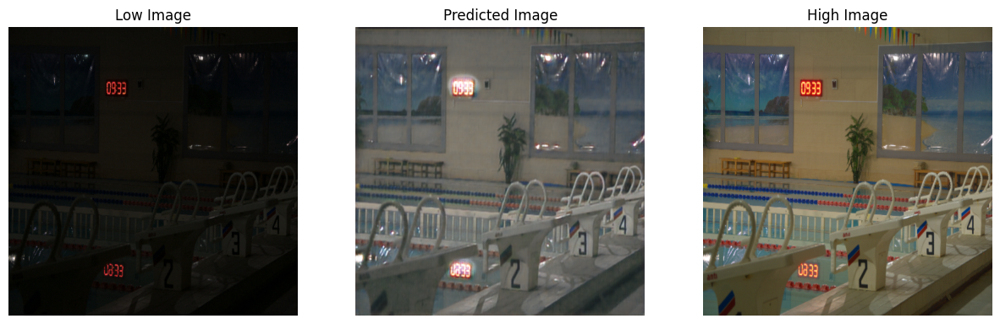

2/2 : /content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low/665.png


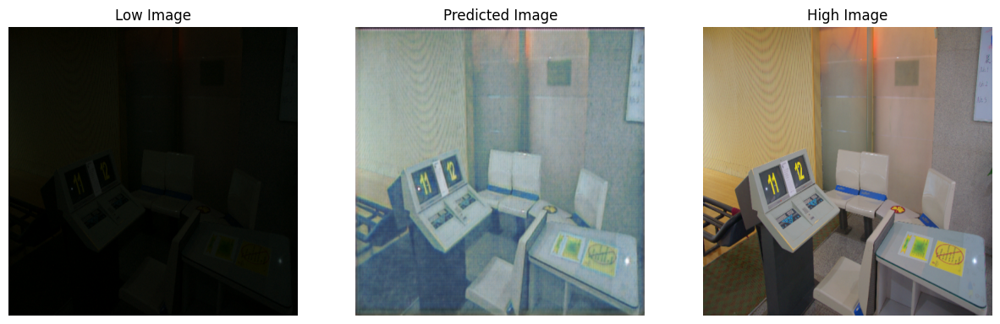

243/243 [==============================] - 97s 391ms/step - loss: 0.0795 - mean_squared_error: 0.0104 - psnr_loss_fn: 69.4130 - ssim_loss_fn: 0.8173 - val_loss: 0.1219 - val_mean_squared_error: 0.0223 - val_psnr_loss_fn: 65.6538 - val_ssim_loss_fn: 0.7408
Epoch 42/100
243/243 [==============================] - 95s 382ms/step - loss: 0.0800 - mean_squared_error: 0.0105 - psnr_loss_fn: 69.3938 - ssim_loss_fn: 0.8168 - val_loss: 0.0923 - val_mean_squared_error: 0.0137 - val_psnr_loss_fn: 68.1317 - val_ssim_loss_fn: 0.7699
Epoch 43/100
243/243 [==============================] - 95s 382ms/step - loss: 0.0787 - mean_squared_error: 0.0104 - psnr_loss_fn: 69.5288 - ssim_loss_fn: 0.8209 - val_loss: 0.0977 - val_mean_squared_error: 0.0141 - val_psnr_loss_fn: 67.4558 - val_ssim_loss_fn: 0.7703
Epoch 44/100
243/243 [==============================] - 95s 383ms/step - loss: 0.0777 - mean_squared_error: 0.0101 - psnr_loss_fn: 69.6242 - ssim_loss_fn: 0.8200 - val_loss: 0.0907 - val_mean_squared_error:

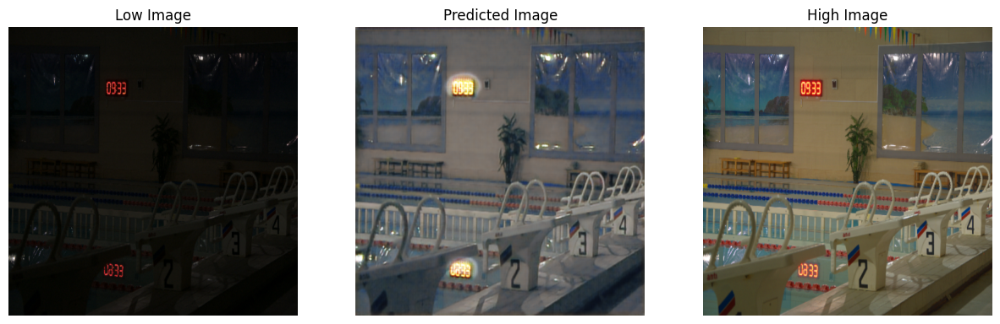

2/2 : /content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low/665.png


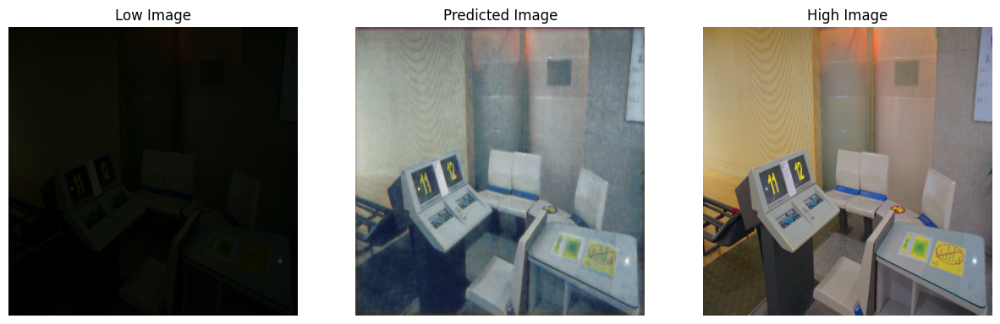

243/243 [==============================] - 98s 393ms/step - loss: 0.0773 - mean_squared_error: 0.0100 - psnr_loss_fn: 69.7772 - ssim_loss_fn: 0.8220 - val_loss: 0.0943 - val_mean_squared_error: 0.0135 - val_psnr_loss_fn: 67.4816 - val_ssim_loss_fn: 0.7863
Epoch 46/100
243/243 [==============================] - 97s 386ms/step - loss: 0.0776 - mean_squared_error: 0.0103 - psnr_loss_fn: 69.7388 - ssim_loss_fn: 0.8215 - val_loss: 0.0982 - val_mean_squared_error: 0.0154 - val_psnr_loss_fn: 67.4539 - val_ssim_loss_fn: 0.7796
Epoch 47/100
243/243 [==============================] - 95s 382ms/step - loss: 0.0753 - mean_squared_error: 0.0095 - psnr_loss_fn: 69.9090 - ssim_loss_fn: 0.8246 - val_loss: 0.0844 - val_mean_squared_error: 0.0113 - val_psnr_loss_fn: 68.8502 - val_ssim_loss_fn: 0.7924
Epoch 48/100
243/243 [==============================] - 95s 382ms/step - loss: 0.0769 - mean_squared_error: 0.0099 - psnr_loss_fn: 69.7588 - ssim_loss_fn: 0.8208 - val_loss: 0.0898 - val_mean_squared_error:

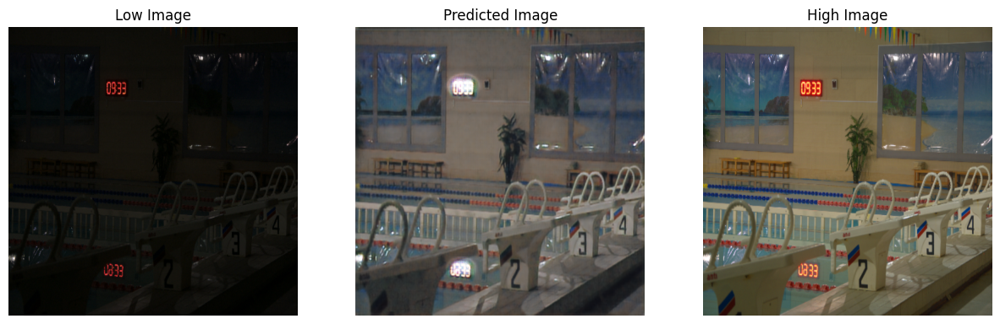

2/2 : /content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low/665.png


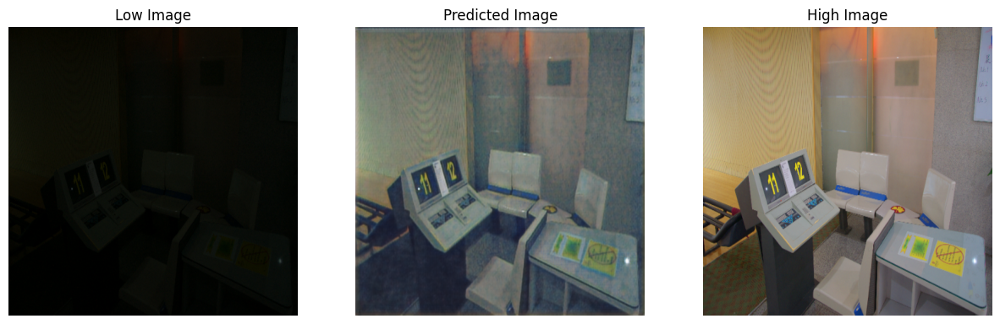

243/243 [==============================] - 97s 390ms/step - loss: 0.0791 - mean_squared_error: 0.0104 - psnr_loss_fn: 69.5361 - ssim_loss_fn: 0.8189 - val_loss: 0.0932 - val_mean_squared_error: 0.0138 - val_psnr_loss_fn: 68.1843 - val_ssim_loss_fn: 0.7725
Epoch 50/100
243/243 [==============================] - 95s 382ms/step - loss: 0.0750 - mean_squared_error: 0.0093 - psnr_loss_fn: 69.8975 - ssim_loss_fn: 0.8239 - val_loss: 0.0827 - val_mean_squared_error: 0.0112 - val_psnr_loss_fn: 68.8776 - val_ssim_loss_fn: 0.7957
Epoch 51/100
243/243 [==============================] - 95s 382ms/step - loss: 0.0733 - mean_squared_error: 0.0089 - psnr_loss_fn: 70.0529 - ssim_loss_fn: 0.8279 - val_loss: 0.1052 - val_mean_squared_error: 0.0191 - val_psnr_loss_fn: 67.6664 - val_ssim_loss_fn: 0.7270
Epoch 52/100
243/243 [==============================] - 95s 383ms/step - loss: 0.0752 - mean_squared_error: 0.0095 - psnr_loss_fn: 70.0005 - ssim_loss_fn: 0.8269 - val_loss: 0.0909 - val_mean_squared_error:

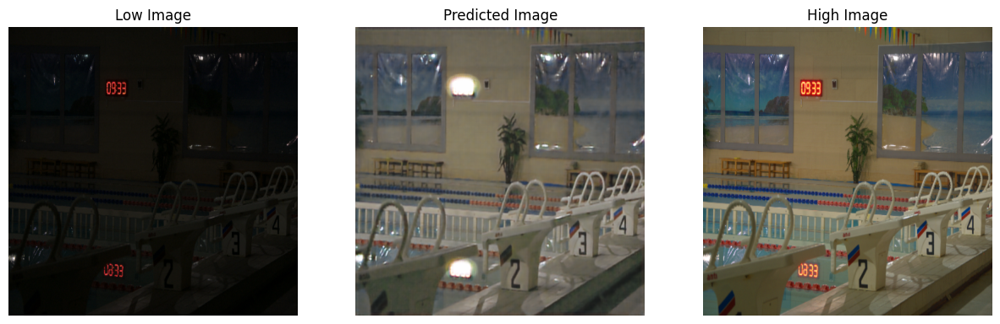

2/2 : /content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low/665.png


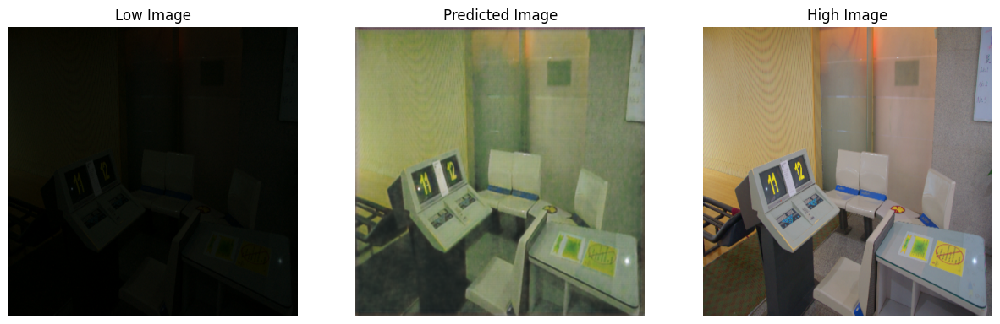

243/243 [==============================] - 97s 393ms/step - loss: 0.0763 - mean_squared_error: 0.0098 - psnr_loss_fn: 69.8884 - ssim_loss_fn: 0.8261 - val_loss: 0.0792 - val_mean_squared_error: 0.0103 - val_psnr_loss_fn: 69.1003 - val_ssim_loss_fn: 0.8045
Epoch 54/100
243/243 [==============================] - 96s 382ms/step - loss: 0.0726 - mean_squared_error: 0.0090 - psnr_loss_fn: 70.1627 - ssim_loss_fn: 0.8270 - val_loss: 0.0985 - val_mean_squared_error: 0.0152 - val_psnr_loss_fn: 67.6429 - val_ssim_loss_fn: 0.7581
Epoch 55/100
243/243 [==============================] - 96s 381ms/step - loss: 0.0725 - mean_squared_error: 0.0087 - psnr_loss_fn: 70.1384 - ssim_loss_fn: 0.8279 - val_loss: 0.0984 - val_mean_squared_error: 0.0159 - val_psnr_loss_fn: 67.5758 - val_ssim_loss_fn: 0.7867
Epoch 56/100
243/243 [==============================] - 95s 381ms/step - loss: 0.0759 - mean_squared_error: 0.0096 - psnr_loss_fn: 69.8224 - ssim_loss_fn: 0.8217 - val_loss: 0.0968 - val_mean_squared_error:

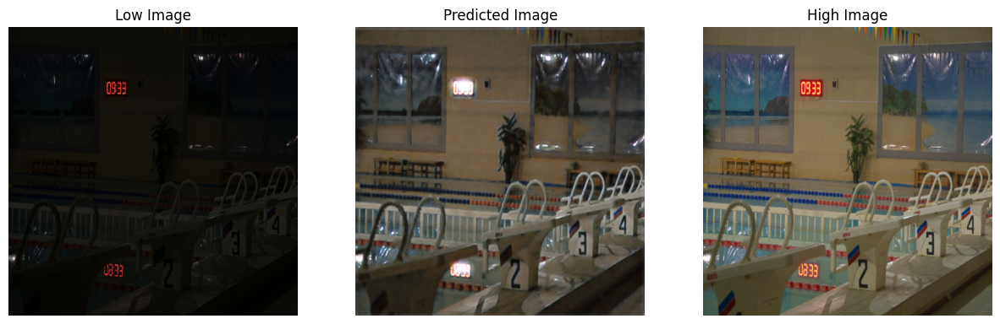

2/2 : /content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low/665.png


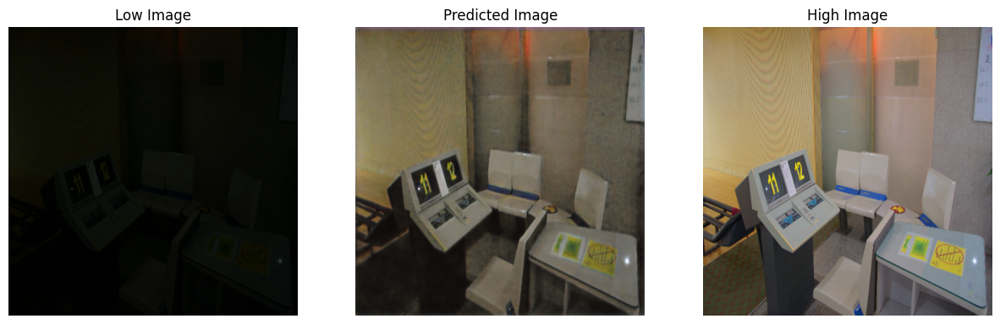

243/243 [==============================] - 97s 393ms/step - loss: 0.0723 - mean_squared_error: 0.0089 - psnr_loss_fn: 70.2222 - ssim_loss_fn: 0.8279 - val_loss: 0.1192 - val_mean_squared_error: 0.0202 - val_psnr_loss_fn: 66.3213 - val_ssim_loss_fn: 0.7539
Epoch 58/100
243/243 [==============================] - 95s 381ms/step - loss: 0.0735 - mean_squared_error: 0.0092 - psnr_loss_fn: 70.0994 - ssim_loss_fn: 0.8266 - val_loss: 0.0962 - val_mean_squared_error: 0.0157 - val_psnr_loss_fn: 68.2059 - val_ssim_loss_fn: 0.7788
Epoch 59/100
243/243 [==============================] - 95s 383ms/step - loss: 0.0732 - mean_squared_error: 0.0090 - psnr_loss_fn: 70.1023 - ssim_loss_fn: 0.8270 - val_loss: 0.0869 - val_mean_squared_error: 0.0120 - val_psnr_loss_fn: 68.7118 - val_ssim_loss_fn: 0.7724
Epoch 60/100
243/243 [==============================] - 95s 385ms/step - loss: 0.0676 - mean_squared_error: 0.0078 - psnr_loss_fn: 70.6764 - ssim_loss_fn: 0.8321 - val_loss: 0.0855 - val_mean_squared_error:

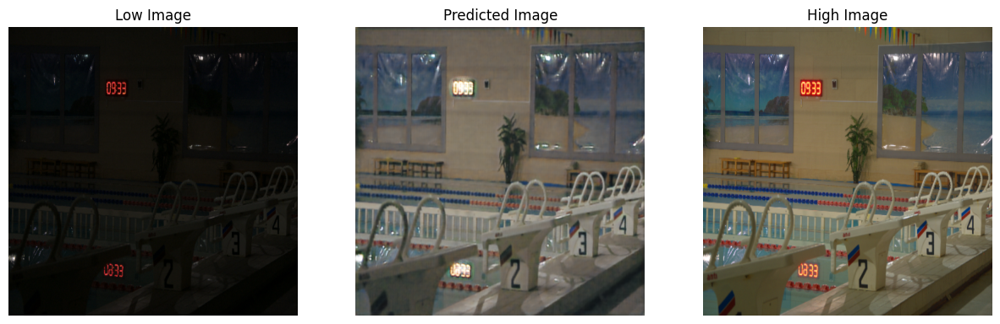

2/2 : /content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low/665.png


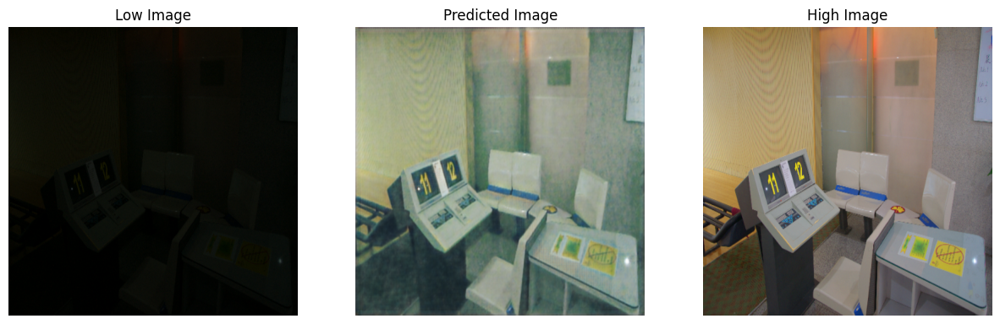

243/243 [==============================] - 97s 390ms/step - loss: 0.0704 - mean_squared_error: 0.0084 - psnr_loss_fn: 70.4569 - ssim_loss_fn: 0.8301 - val_loss: 0.1031 - val_mean_squared_error: 0.0208 - val_psnr_loss_fn: 68.0802 - val_ssim_loss_fn: 0.7802
Epoch 62/100
243/243 [==============================] - 95s 381ms/step - loss: 0.0690 - mean_squared_error: 0.0081 - psnr_loss_fn: 70.6324 - ssim_loss_fn: 0.8306 - val_loss: 0.1090 - val_mean_squared_error: 0.0180 - val_psnr_loss_fn: 67.1772 - val_ssim_loss_fn: 0.7920
Epoch 63/100
243/243 [==============================] - 95s 382ms/step - loss: 0.0710 - mean_squared_error: 0.0085 - psnr_loss_fn: 70.3751 - ssim_loss_fn: 0.8290 - val_loss: 0.0879 - val_mean_squared_error: 0.0120 - val_psnr_loss_fn: 68.5781 - val_ssim_loss_fn: 0.7923
Epoch 64/100
243/243 [==============================] - 95s 382ms/step - loss: 0.0681 - mean_squared_error: 0.0080 - psnr_loss_fn: 70.7825 - ssim_loss_fn: 0.8360 - val_loss: 0.0889 - val_mean_squared_error:

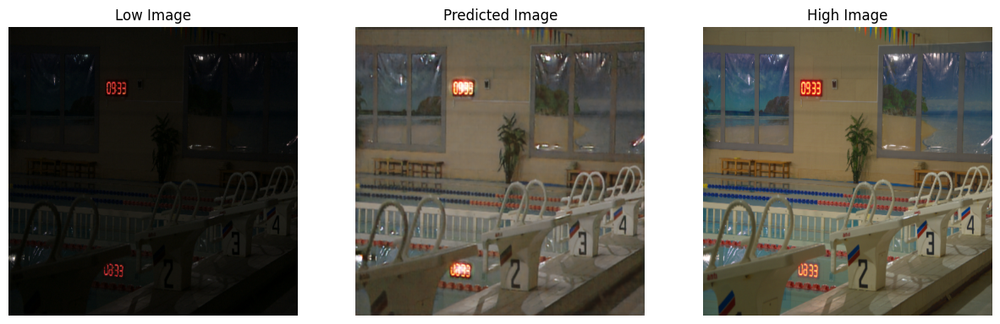

2/2 : /content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low/665.png


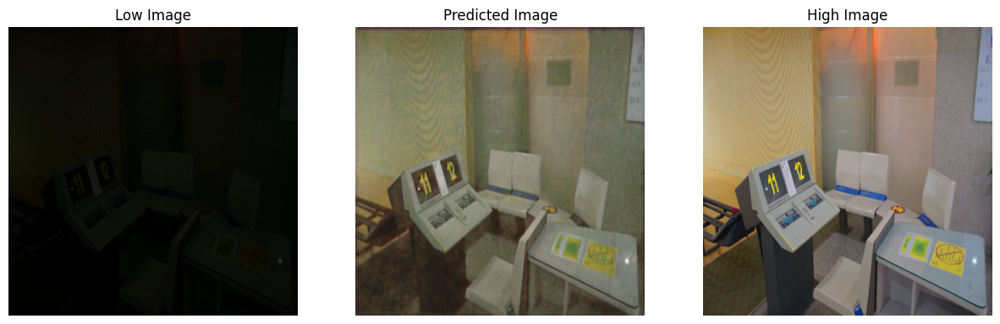

243/243 [==============================] - 97s 392ms/step - loss: 0.0698 - mean_squared_error: 0.0081 - psnr_loss_fn: 70.4386 - ssim_loss_fn: 0.8333 - val_loss: 0.0872 - val_mean_squared_error: 0.0116 - val_psnr_loss_fn: 68.7392 - val_ssim_loss_fn: 0.8101
Epoch 66/100
243/243 [==============================] - 95s 383ms/step - loss: 0.0687 - mean_squared_error: 0.0081 - psnr_loss_fn: 70.6488 - ssim_loss_fn: 0.8331 - val_loss: 0.0899 - val_mean_squared_error: 0.0128 - val_psnr_loss_fn: 68.5437 - val_ssim_loss_fn: 0.7971
Epoch 67/100
243/243 [==============================] - 96s 383ms/step - loss: 0.0687 - mean_squared_error: 0.0079 - psnr_loss_fn: 70.5182 - ssim_loss_fn: 0.8321 - val_loss: 0.0836 - val_mean_squared_error: 0.0106 - val_psnr_loss_fn: 69.0191 - val_ssim_loss_fn: 0.8013
Epoch 68/100
243/243 [==============================] - 95s 383ms/step - loss: 0.0676 - mean_squared_error: 0.0079 - psnr_loss_fn: 70.7601 - ssim_loss_fn: 0.8350 - val_loss: 0.0901 - val_mean_squared_error:

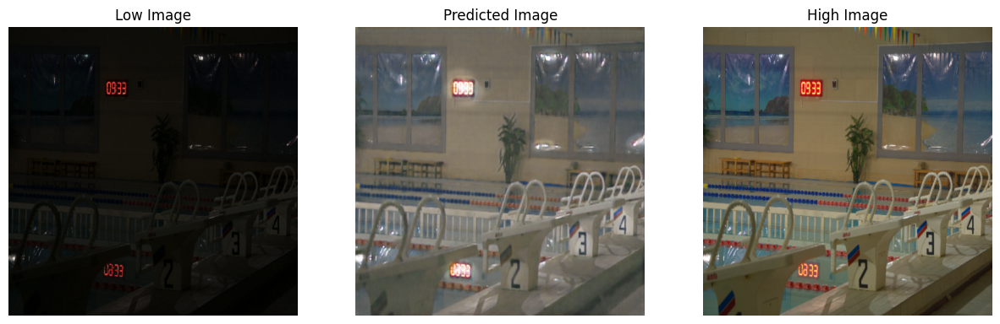

2/2 : /content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low/665.png


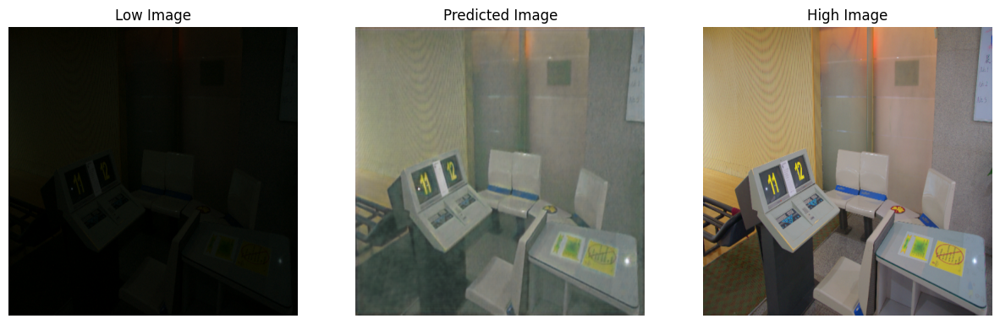

243/243 [==============================] - 97s 391ms/step - loss: 0.0687 - mean_squared_error: 0.0081 - psnr_loss_fn: 70.6496 - ssim_loss_fn: 0.8351 - val_loss: 0.0841 - val_mean_squared_error: 0.0108 - val_psnr_loss_fn: 68.7823 - val_ssim_loss_fn: 0.8014
Epoch 70/100
243/243 [==============================] - 97s 388ms/step - loss: 0.0674 - mean_squared_error: 0.0078 - psnr_loss_fn: 70.7778 - ssim_loss_fn: 0.8363 - val_loss: 0.0830 - val_mean_squared_error: 0.0111 - val_psnr_loss_fn: 69.1966 - val_ssim_loss_fn: 0.8004
Epoch 71/100
243/243 [==============================] - 94s 379ms/step - loss: 0.0673 - mean_squared_error: 0.0078 - psnr_loss_fn: 70.8220 - ssim_loss_fn: 0.8367 - val_loss: 0.0913 - val_mean_squared_error: 0.0141 - val_psnr_loss_fn: 68.2965 - val_ssim_loss_fn: 0.7895
Epoch 72/100
243/243 [==============================] - 96s 383ms/step - loss: 0.0681 - mean_squared_error: 0.0081 - psnr_loss_fn: 70.7694 - ssim_loss_fn: 0.8361 - val_loss: 0.0924 - val_mean_squared_error:

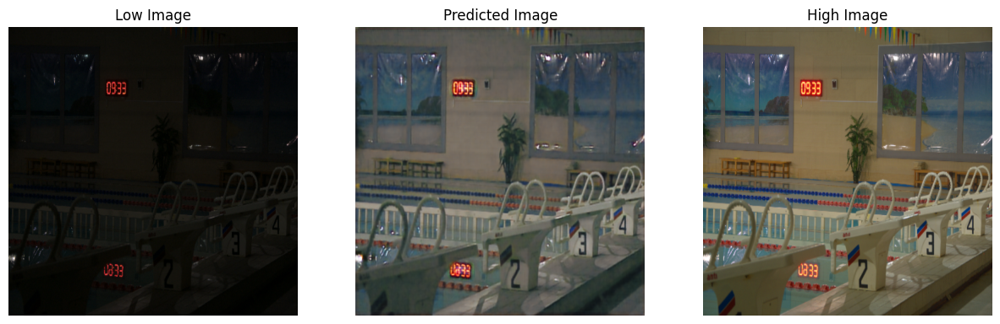

2/2 : /content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low/665.png


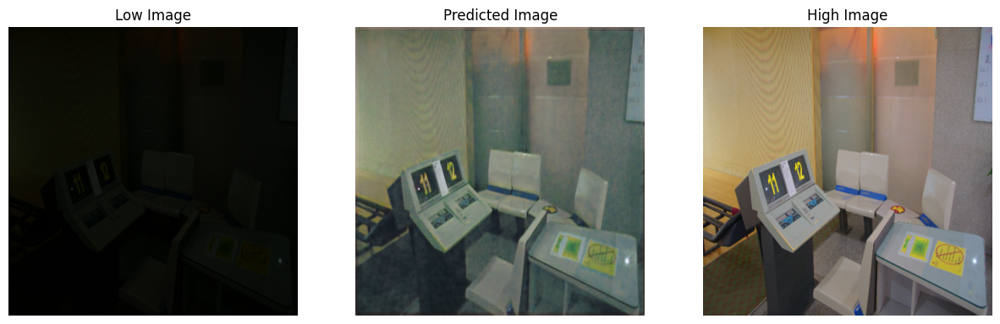

243/243 [==============================] - 97s 391ms/step - loss: 0.0673 - mean_squared_error: 0.0079 - psnr_loss_fn: 70.8233 - ssim_loss_fn: 0.8390 - val_loss: 0.0902 - val_mean_squared_error: 0.0130 - val_psnr_loss_fn: 68.4882 - val_ssim_loss_fn: 0.8036
Epoch 74/100
243/243 [==============================] - 96s 387ms/step - loss: 0.0675 - mean_squared_error: 0.0079 - psnr_loss_fn: 70.7855 - ssim_loss_fn: 0.8368 - val_loss: 0.0893 - val_mean_squared_error: 0.0134 - val_psnr_loss_fn: 68.7275 - val_ssim_loss_fn: 0.8029
Epoch 75/100
243/243 [==============================] - 97s 386ms/step - loss: 0.0667 - mean_squared_error: 0.0076 - psnr_loss_fn: 70.8645 - ssim_loss_fn: 0.8383 - val_loss: 0.0974 - val_mean_squared_error: 0.0150 - val_psnr_loss_fn: 67.9700 - val_ssim_loss_fn: 0.7829
Epoch 76/100
243/243 [==============================] - 94s 381ms/step - loss: 0.0644 - mean_squared_error: 0.0074 - psnr_loss_fn: 71.0718 - ssim_loss_fn: 0.8387 - val_loss: 0.0912 - val_mean_squared_error:

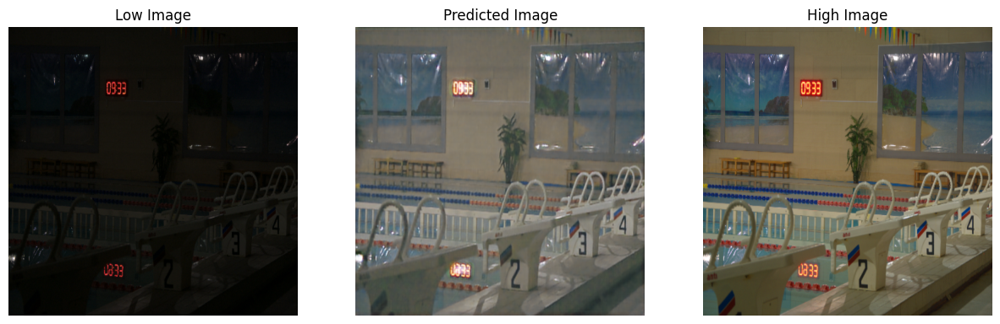

2/2 : /content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low/665.png


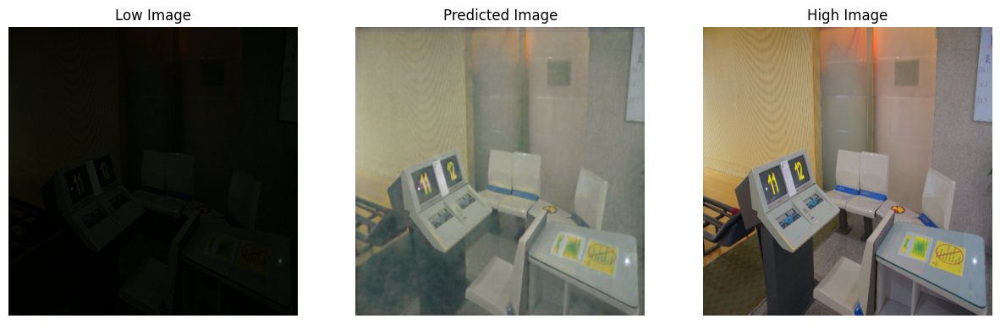

243/243 [==============================] - 95s 384ms/step - loss: 0.0655 - mean_squared_error: 0.0075 - psnr_loss_fn: 71.0309 - ssim_loss_fn: 0.8415 - val_loss: 0.0944 - val_mean_squared_error: 0.0131 - val_psnr_loss_fn: 67.8994 - val_ssim_loss_fn: 0.7978
Epoch 78/100
243/243 [==============================] - 96s 381ms/step - loss: 0.0675 - mean_squared_error: 0.0079 - psnr_loss_fn: 70.8033 - ssim_loss_fn: 0.8383 - val_loss: 0.0926 - val_mean_squared_error: 0.0155 - val_psnr_loss_fn: 68.1756 - val_ssim_loss_fn: 0.7929
Epoch 79/100
243/243 [==============================] - 98s 391ms/step - loss: 0.0653 - mean_squared_error: 0.0074 - psnr_loss_fn: 71.0244 - ssim_loss_fn: 0.8408 - val_loss: 0.0785 - val_mean_squared_error: 0.0104 - val_psnr_loss_fn: 69.6674 - val_ssim_loss_fn: 0.8155
Epoch 80/100
243/243 [==============================] - 97s 388ms/step - loss: 0.0640 - mean_squared_error: 0.0073 - psnr_loss_fn: 71.2223 - ssim_loss_fn: 0.8422 - val_loss: 0.0934 - val_mean_squared_error:

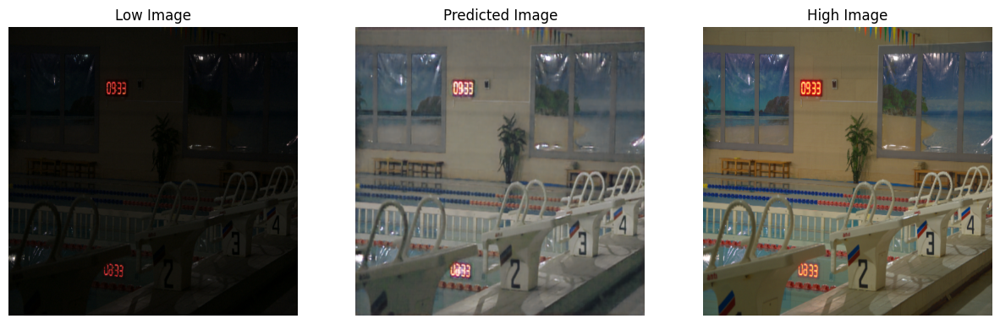

2/2 : /content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low/665.png


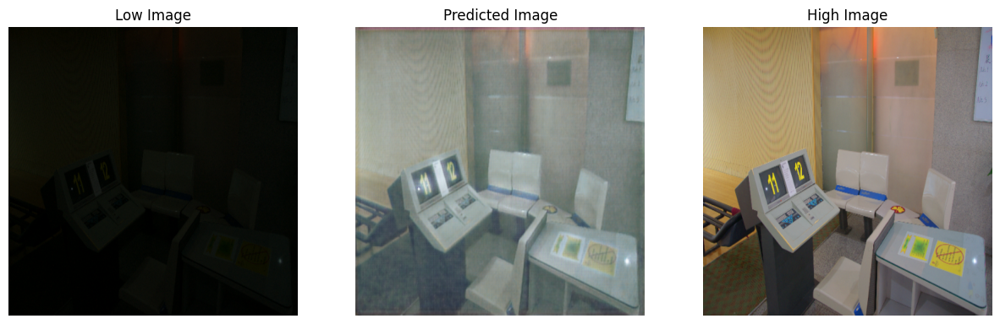

243/243 [==============================] - 98s 396ms/step - loss: 0.0634 - mean_squared_error: 0.0070 - psnr_loss_fn: 71.2152 - ssim_loss_fn: 0.8440 - val_loss: 0.1120 - val_mean_squared_error: 0.0233 - val_psnr_loss_fn: 66.9662 - val_ssim_loss_fn: 0.7675
Epoch 82/100
243/243 [==============================] - 97s 388ms/step - loss: 0.0648 - mean_squared_error: 0.0074 - psnr_loss_fn: 71.0732 - ssim_loss_fn: 0.8402 - val_loss: 0.0880 - val_mean_squared_error: 0.0123 - val_psnr_loss_fn: 68.5931 - val_ssim_loss_fn: 0.8061
Epoch 83/100
243/243 [==============================] - 95s 385ms/step - loss: 0.0651 - mean_squared_error: 0.0073 - psnr_loss_fn: 71.0777 - ssim_loss_fn: 0.8428 - val_loss: 0.0938 - val_mean_squared_error: 0.0140 - val_psnr_loss_fn: 67.9198 - val_ssim_loss_fn: 0.7769
Epoch 84/100
243/243 [==============================] - 98s 388ms/step - loss: 0.0637 - mean_squared_error: 0.0071 - psnr_loss_fn: 71.2336 - ssim_loss_fn: 0.8419 - val_loss: 0.0797 - val_mean_squared_error:

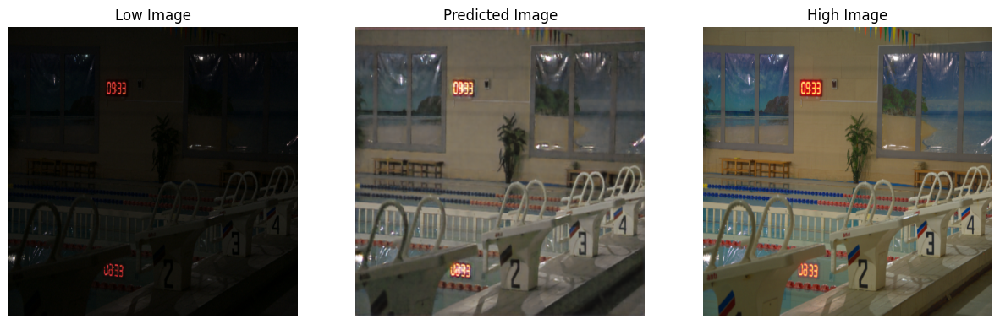

2/2 : /content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low/665.png


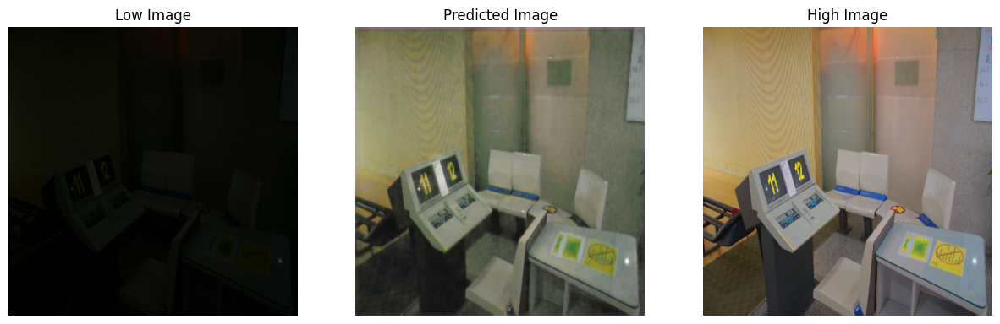

243/243 [==============================] - 98s 392ms/step - loss: 0.0638 - mean_squared_error: 0.0071 - psnr_loss_fn: 71.2249 - ssim_loss_fn: 0.8416 - val_loss: 0.0839 - val_mean_squared_error: 0.0113 - val_psnr_loss_fn: 69.2129 - val_ssim_loss_fn: 0.8080
Epoch 86/100
243/243 [==============================] - 97s 387ms/step - loss: 0.0636 - mean_squared_error: 0.0072 - psnr_loss_fn: 71.2701 - ssim_loss_fn: 0.8416 - val_loss: 0.0930 - val_mean_squared_error: 0.0166 - val_psnr_loss_fn: 68.5633 - val_ssim_loss_fn: 0.8026
Epoch 87/100
243/243 [==============================] - 95s 384ms/step - loss: 0.0642 - mean_squared_error: 0.0071 - psnr_loss_fn: 71.1441 - ssim_loss_fn: 0.8426 - val_loss: 0.0942 - val_mean_squared_error: 0.0131 - val_psnr_loss_fn: 68.1489 - val_ssim_loss_fn: 0.7986
Epoch 88/100
243/243 [==============================] - 97s 388ms/step - loss: 0.0617 - mean_squared_error: 0.0066 - psnr_loss_fn: 71.4598 - ssim_loss_fn: 0.8451 - val_loss: 0.0932 - val_mean_squared_error:

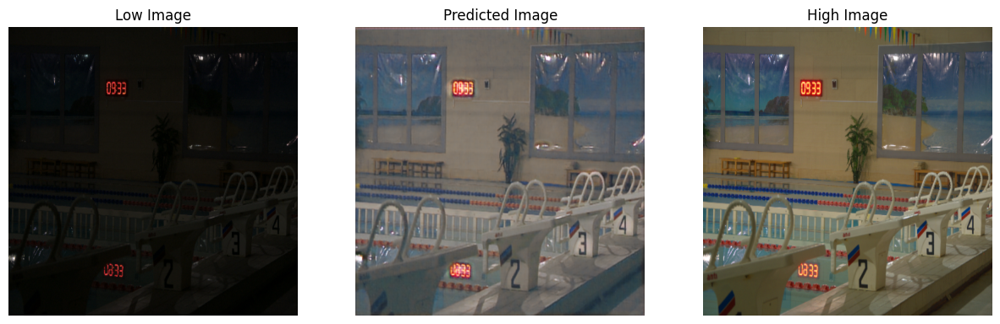

2/2 : /content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low/665.png


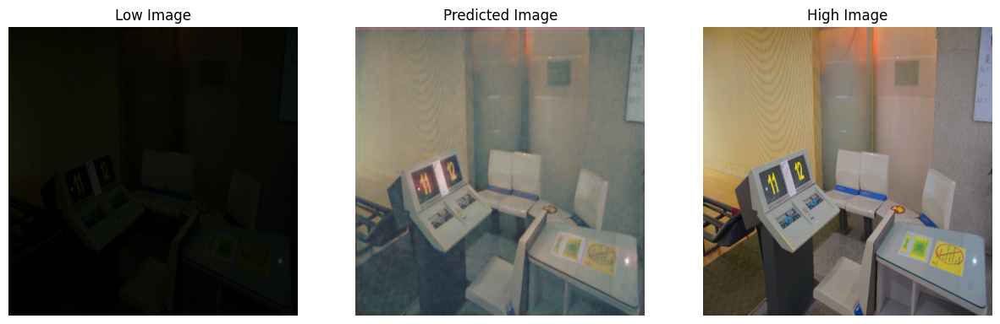

243/243 [==============================] - 98s 397ms/step - loss: 0.0622 - mean_squared_error: 0.0068 - psnr_loss_fn: 71.4395 - ssim_loss_fn: 0.8428 - val_loss: 0.0924 - val_mean_squared_error: 0.0127 - val_psnr_loss_fn: 68.1703 - val_ssim_loss_fn: 0.7833
Epoch 90/100
243/243 [==============================] - 95s 385ms/step - loss: 0.0617 - mean_squared_error: 0.0066 - psnr_loss_fn: 71.4260 - ssim_loss_fn: 0.8457 - val_loss: 0.0909 - val_mean_squared_error: 0.0141 - val_psnr_loss_fn: 68.8983 - val_ssim_loss_fn: 0.8021
Epoch 91/100
243/243 [==============================] - 98s 388ms/step - loss: 0.0620 - mean_squared_error: 0.0067 - psnr_loss_fn: 71.4328 - ssim_loss_fn: 0.8456 - val_loss: 0.0885 - val_mean_squared_error: 0.0124 - val_psnr_loss_fn: 69.0921 - val_ssim_loss_fn: 0.8161
Epoch 92/100
243/243 [==============================] - 97s 385ms/step - loss: 0.0623 - mean_squared_error: 0.0068 - psnr_loss_fn: 71.4166 - ssim_loss_fn: 0.8449 - val_loss: 0.0944 - val_mean_squared_error:

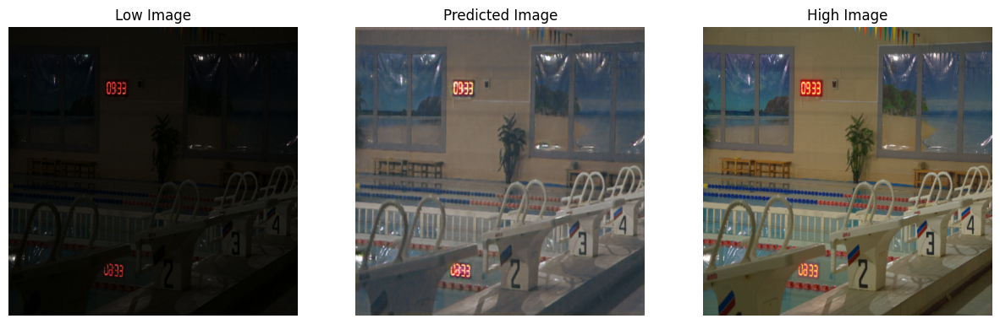

2/2 : /content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low/665.png


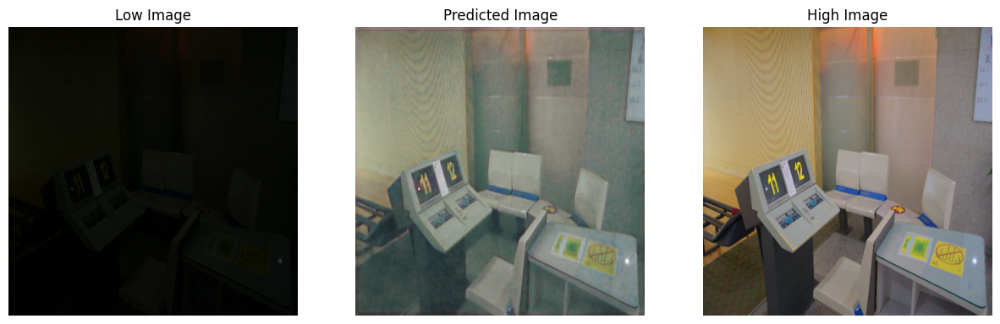

243/243 [==============================] - 99s 393ms/step - loss: 0.0623 - mean_squared_error: 0.0069 - psnr_loss_fn: 71.4463 - ssim_loss_fn: 0.8442 - val_loss: 0.0838 - val_mean_squared_error: 0.0110 - val_psnr_loss_fn: 69.0019 - val_ssim_loss_fn: 0.8059
Epoch 94/100
243/243 [==============================] - 97s 388ms/step - loss: 0.0605 - mean_squared_error: 0.0065 - psnr_loss_fn: 71.6231 - ssim_loss_fn: 0.8470 - val_loss: 0.0937 - val_mean_squared_error: 0.0155 - val_psnr_loss_fn: 68.4945 - val_ssim_loss_fn: 0.7925
Epoch 95/100
243/243 [==============================] - 98s 388ms/step - loss: 0.0595 - mean_squared_error: 0.0063 - psnr_loss_fn: 71.7987 - ssim_loss_fn: 0.8480 - val_loss: 0.0905 - val_mean_squared_error: 0.0122 - val_psnr_loss_fn: 68.5066 - val_ssim_loss_fn: 0.8115
Epoch 96/100
243/243 [==============================] - 98s 389ms/step - loss: 0.0617 - mean_squared_error: 0.0068 - psnr_loss_fn: 71.5038 - ssim_loss_fn: 0.8453 - val_loss: 0.0877 - val_mean_squared_error:

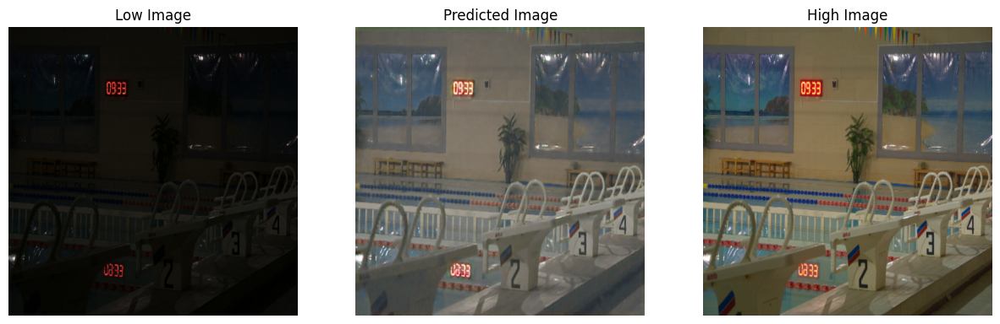

2/2 : /content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low/665.png


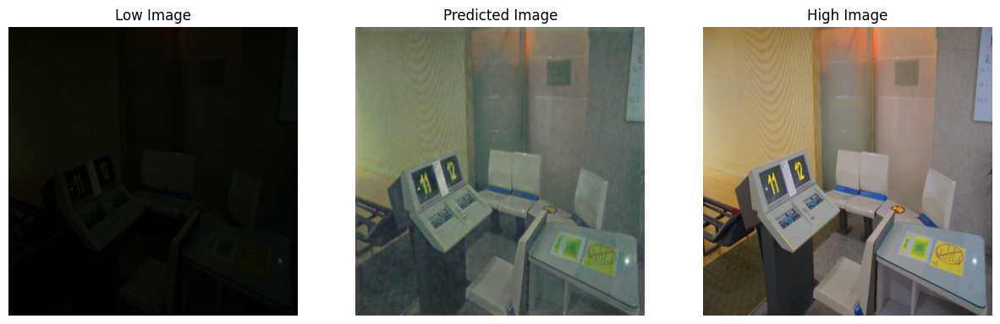

243/243 [==============================] - 100s 399ms/step - loss: 0.0635 - mean_squared_error: 0.0071 - psnr_loss_fn: 71.3754 - ssim_loss_fn: 0.8444 - val_loss: 0.0932 - val_mean_squared_error: 0.0143 - val_psnr_loss_fn: 68.5859 - val_ssim_loss_fn: 0.8002
Epoch 98/100
243/243 [==============================] - 98s 388ms/step - loss: 0.0609 - mean_squared_error: 0.0065 - psnr_loss_fn: 71.5493 - ssim_loss_fn: 0.8471 - val_loss: 0.0923 - val_mean_squared_error: 0.0126 - val_psnr_loss_fn: 68.4182 - val_ssim_loss_fn: 0.7894
Epoch 99/100
243/243 [==============================] - 97s 388ms/step - loss: 0.0598 - mean_squared_error: 0.0064 - psnr_loss_fn: 71.7309 - ssim_loss_fn: 0.8470 - val_loss: 0.0879 - val_mean_squared_error: 0.0130 - val_psnr_loss_fn: 69.2321 - val_ssim_loss_fn: 0.8153
Epoch 100/100
214/243 [=========================>....] - ETA: 10s - loss: 0.0612 - mean_squared_error: 0.0067 - psnr_loss_fn: 71.5219 - ssim_loss_fn: 0.8475

In [ ]:
# Train for 10 epochs

hist = model.fit(train, epochs=EPOCHS, validation_data = val, callbacks=[tensorboard_callback,save_best_model_checkpoint,
                                                                        PredictionCallback(log_interval = LOG_INTERVALS)])


In [ ]:
model.save("VGGv2.h5")

## **Performace Check**

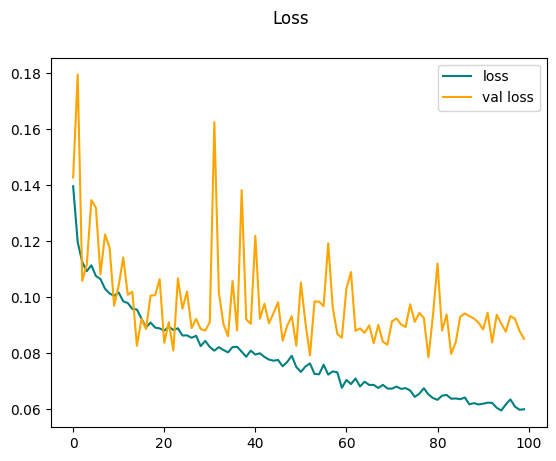

In [ ]:
plt.plot(hist.history['loss'], color='teal', label='loss')
plt.plot(hist.history['val_loss'], color='orange', label='val loss')
plt.suptitle('Loss')
plt.legend()
plt.show()

In [ ]:
%load_ext tensorboard

In [ ]:
%tensorboard --logdir './logs'

<IPython.core.display.Javascript object>

## **Make Predictions on Test**

In [ ]:
test_data = test.as_numpy_iterator()
test_sample = test_data.next()

In [ ]:
print(test_sample[0].shape)

(2, 512, 512, 3)


In [ ]:
yhat = model.predict(test_sample[0])

1/1 [==============================] - 0s 98ms/step


## 4-**Inferencing**

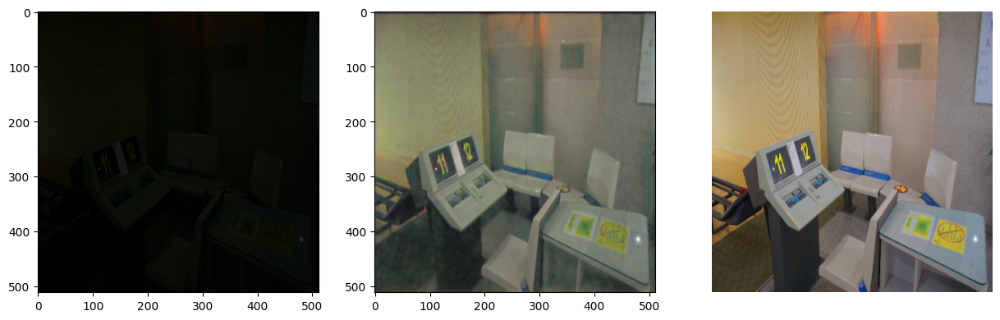

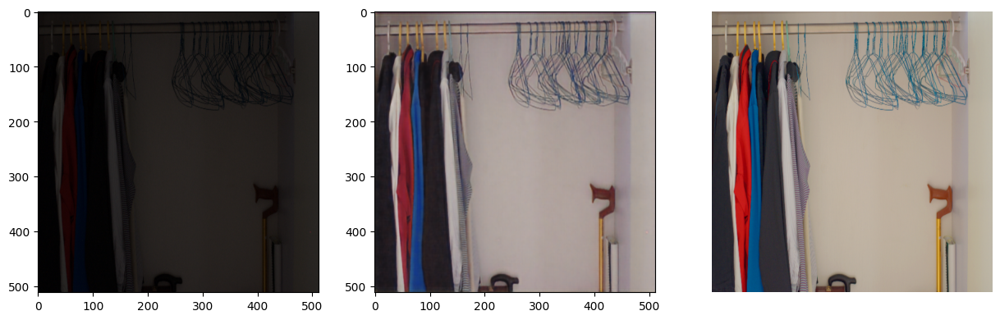

In [ ]:
low_1 = test_sample[0][0]
low_2 = test_sample[0][1]

pred_1 = yhat[0]
pred_2 = yhat[1]

high_1 = test_sample[1][0]
high_2 = test_sample[1][1]

fig, ax = plt.subplots(ncols=3, figsize=(15,10));
ax[0].imshow(low_1);
ax[1].imshow(pred_1);
ax[2].imshow(high_1);
plt.axis('off');

fig, ax = plt.subplots(ncols=3, figsize=(15,10));
ax[0].imshow(low_2);
ax[1].imshow(pred_2);
ax[2].imshow(high_2);
plt.axis('off');

## **Inferencing**

In [ ]:
IMAGE_WIDTH,IMAGE_HEIGHT = 512,512

In [ ]:
def load_image(x): 
    byte_img = tf.io.read_file(x)
    img = tf.io.decode_jpeg(byte_img)
    return img

In [ ]:
def preprocess_image(img_path):
  img = load_image(img_path)
  img = tf.image.resize(img, (IMAGE_WIDTH,IMAGE_HEIGHT))
  img = img/255;
  return img

In [ ]:
test_lowimg_path = r'/content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low/1.png'
test_highimg_path = r'/content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/high/1.png'

In [ ]:
LowImg = preprocess_image(test_lowimg_path)
HighImg = preprocess_image(test_highimg_path)

In [ ]:
test_prediction = model.predict(np.expand_dims(LowImg,axis=0))

1/1 [==============================] - 0s 51ms/step


In [ ]:
fig, ax = plt.subplots(ncols=3, figsize=(15,10));
ax[0].imshow(LowImg);
ax[1].imshow(test_prediction[0]);
ax[2].imshow(HighImg);

In [ ]:
test_low_path = r'/content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low'
test_high_path = r'/content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/high'

In [ ]:
def find_target_img_path(test_img_file):
  test_img_filename = os.path.basename(test_img_file)
  high_img_path = os.path.join(test_high_path,test_img_filename)
  return high_img_path

In [ ]:
# saving
save_folder_name = 'VGG_LowLight_Results_char_loss_v3_e100'
save_folder_path = os.path.join(HOME,save_folder_name)
if not os.path.exists(save_folder_path):
  print("DIRECTORY CREATED")
  os.makedirs(save_folder_path)

In [ ]:
test_low_images = os.listdir(test_low_path)

#n_images = 2
n_images = len(test_low_images)

for i,image_name in enumerate(test_low_images):
  if i==n_images:
    break
  image_path = os.path.join(test_low_path,image_name)
  print(f'{i+1}/{n_images} : {image_path}')
  low_img = preprocess_image(image_path)
  prediction = model.predict(np.expand_dims(low_img,axis=0),verbose=0)

  high_img_path = find_target_img_path(image_path)
  high_img = preprocess_image(high_img_path)

  fig, ax = plt.subplots(ncols=3, figsize=(15,10));
  ax[0].imshow(low_img);
  ax[1].imshow(prediction[0]);
  ax[2].imshow(high_img);
  ax[0].axis('off');
  ax[1].axis('off');
  ax[2].axis('off');
  ax[0].set_title("Low Image")
  ax[1].set_title("Predicted Image")
  ax[2].set_title("High Image")
  plt.show()

  ### save
  save_name = f'VGG_{image_name.split(".")[0]}.png'
  save_path = os.path.join(save_folder_path,save_name)
  fig.savefig(save_path,bbox_inches='tight',dpi=300);